# NGC 628 (M74, UGC 1149)  2D small

In [1]:
from IPython.display import HTML
from IPython.display import Image
import os
from PIL import Image as ImagePIL
import itertools
import time
from astropy.io import fits
import cv2
import matplotlib.patches as patches

from scipy.interpolate import (
    LinearNDInterpolator, RectBivariateSpline,
    RegularGridInterpolator)
from scipy.ndimage import map_coordinates
# https://nbviewer.jupyter.org/github/pierre-haessig/stodynprog/blob/master/stodynprog/linear_interp_benchmark.ipynb

%pylab
%matplotlib inline
%run ../../utils/load_notebook.py

Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


In [2]:
from utils import *

importing Jupyter notebook from utils.ipynb
importing Jupyter notebook from instabilities.ipynb
Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


In [3]:
from photometry import *

importing Jupyter notebook from photometry.ipynb
Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


In [4]:
from instabilities import *

* [NED](https://ned.ipac.caltech.edu/cgi-bin/objsearch?objname=n628&extend=no&hconst=73&omegam=0.27&omegav=0.73&corr_z=1&out_csys=Equatorial&out_equinox=J2000.0&obj_sort=RA+or+Longitude&of=pre_text&zv_breaker=30000.0&list_limit=5&img_stamp=YES)
* [HYPERLEDA](http://leda.univ-lyon1.fr/ledacat.cgi?o=n628)

In [5]:
name = 'NGC628'
# gtype = 'SBm' #LEDA
incl = 7.0  #Leroy, Walter08
distance = 7.3 #Mpc, Walter08
scale = calc_scale(distance) #kpc/arcsec

data_path = '../../data/ngc628'
sin_i, cos_i = np.sin(incl*np.pi/180.), np.cos(incl*np.pi/180.)
print 'sin_i={:5.5f}, cos_i={:5.5f}, scale={:5.5f} kpc/arcsec'.format(sin_i, cos_i, scale)

sin_i=0.12187, cos_i=0.99255, scale=0.03539 kpc/arcsec


Мотивация: результат из Leroy 2008

In [6]:
os.chdir(data_path)

Полезные функции:

In [7]:
def color_to_level(color, colorbar, barlen, zeroval, scale):
    '''Вычисляем исходную величину из цвета colorbar'''
    argmin = np.argmin(np.linalg.norm(colorbar - color, axis=1))
    return (zeroval + (barlen-argmin)/scale)

def image_map_to_colorbar(img_raw, colorbar, scale, zeroval):
    '''Переводим рисунок в значения, соответствующие его colorbar'''
    height, width = img_raw.height, img_raw.width
    X,Y = np.meshgrid(np.arange(0.,width,1), np.arange(0.,height,1))
    fdata = list(img_raw.getdata())
    try:
        Z = np.array(fdata).reshape(height, width, 4)
    except ValueError:
        Z = np.array(fdata).reshape(height, width, 3)
    Z = np.apply_along_axis(lambda l: color_to_level(l, colorbar, len(colorbar), zeroval, scale), 2, Z)
    Z = Z[::-1, :] #inverse axes
    return Z

def resize_image(img_old, width, height, yinterp=None, xinterp=None):
    '''Изменяем размер картнки интерполяцией на другую сетку'''
    start = time.time()
    old_height, old_width = img_old.shape
    xgrid = np.arange(0.,len(img_old),1)
    ygrid = np.arange(0.,len(img_old[0]),1)
    f_2d_grid = img_old[::-1, :]
    if yinterp is None:
        yinterp = np.linspace(0., old_width, width)
    if xinterp is None:
        xinterp = np.linspace(0., old_height, height)
    points_x, points_y = np.broadcast_arrays(xgrid.reshape(-1,1), ygrid)
    points = np.vstack((points_x.flatten(),
                        points_y.flatten())).T
    values = f_2d_grid.flatten()
    f_2d_interp = LinearNDInterpolator(points, values)
    tmp = f_2d_interp(xinterp.reshape(-1,1), yinterp)
    print 'resize take {:2.2f} sec'.format(time.time()-start)
    return tmp[::-1, :]

# Источники, мотивация и картинки

[The Star Formation Efficiency in Nearby Galaxies: Measuring Where Gas Forms Stars Effectively](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2782/pdf) Leroy 2008

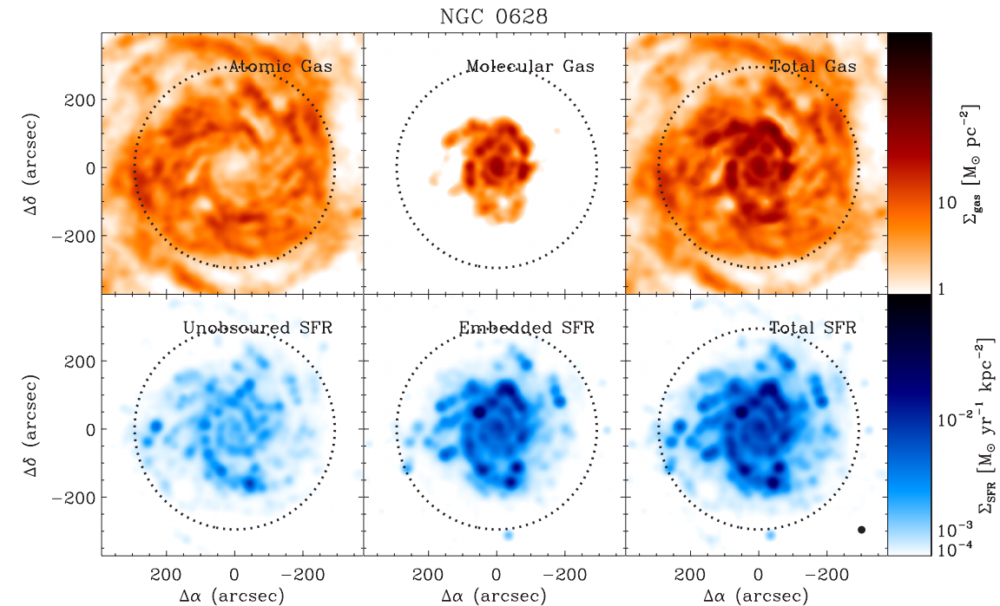

In [6]:
Image('Leroy2008_maps.png')

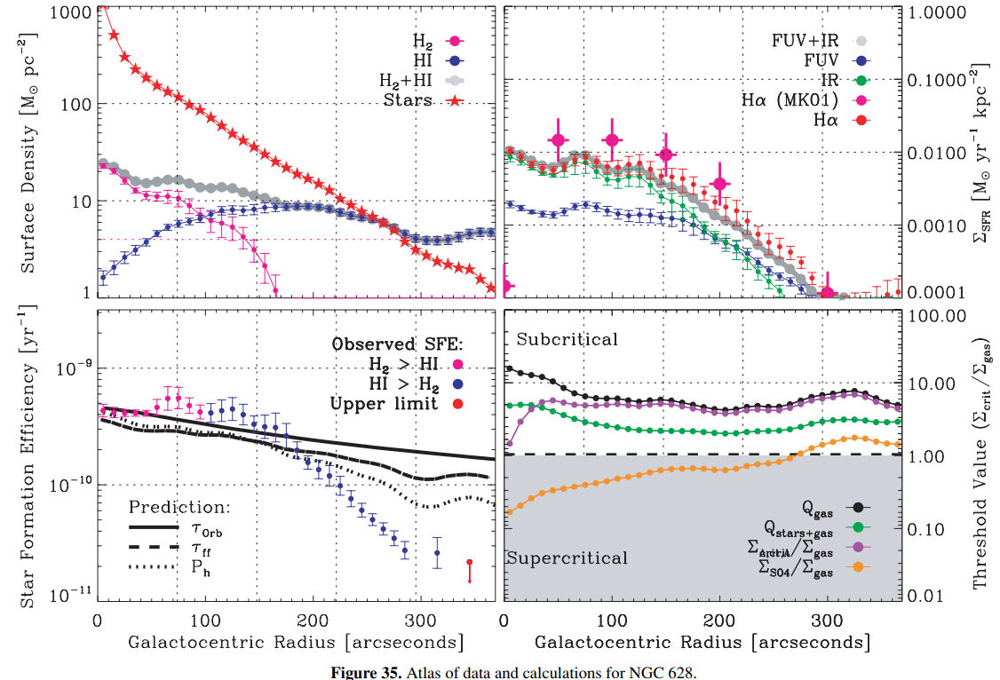

In [7]:
Image('Leroy2008_results.png')

* [THINGS: THE H i NEARBY GALAXY SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2563/pdf) Walter 2008 - $I_{HI}, V_{HI}, \sigma_{HI}$
* https://arxiv.org/pdf/1612.05272.pdf - velocity dispersion of the HI gas, and early work with the WSRT indicated a value around 10 km/s, with a slight enhancement in star forming regions as found for NGC 628 by Shostak and van der Kruit (1984)
* [THE BIMA SURVEY OF NEARBY GALAXIES. I. THE RADIAL DISTRIBUTION OF CO EMISSION IN SPIRAL GALAXIES](http://iopscience.iop.org/article/10.1086/323221/pdf)-$I_{CO}$
* [THE VIRUS-P EXPLORATION OF NEARBY GALAXIES (VENGA): SURVEY DESIGN, DATA PROCESSING, AND SPECTRAL ANALYSIS METHODS](http://iopscience.iop.org/article/10.1088/0004-6256/145/5/138/pdf) - $V_*, \sigma_*$
* [THE VIRUS-P EXPLORATION OF NEARBY GALAXIES (VENGA): THE XCO GRADIENT IN NGC 628](http://iopscience.iop.org/article/10.1088/0004-637X/764/2/117/pdf) - Данные по $SFR$, $I_{CO}$ из HERACLES, BIMA, CARMS, карта металличности, изучение $X_{CO}$
>We caution against adopting a single XCO value when large changes in gas surface density
or metallicity are present.
* [The JCMT Nearby Galaxies Legacy Survey – IV. Velocity dispersions in the molecular interstellar medium in spiral galaxies](https://ui.adsabs.harvard.edu/#abs/2011MNRAS.410.1409W/abstract)- $\sigma_{CO(3-2)}$
>CO J = 3–2 velocity dispersion for six galaxies which are not members of the Virgo cluster. (a) NGC 628. Contour levels are 2.5, 5 and 10 km s−1
and the colour scale peak is 15 km s−1.
* [COMPARING C ii, H i, AND CO DYNAMICS OF NEARBY GALAXIES](https://arxiv.org/pdf/1604.08777.pdf)- есть карта скоростей CII, HI и CO
* [CO(J = 3 − 2) On-the-fly Mapping of the Nearby Spiral Galaxies NGC 628 and NGC 7793: Spatially-resolved CO(J = 3 − 2) Star-formation Law](https://arxiv.org/pdf/1512.04159.pdf)-$I_{CO(3-2)}$
* [HI AND CO VELOCITY DISPERSIONS IN NEARBY GALAXIES](https://arxiv.org/pdf/1511.06006.pdf) - радиальные профили $\sigma_{HI}, \sigma_{CO}$, можно использовать для проверки
* [HERACLES: THE HERA CO LINE EXTRAGALACTIC SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/137/6/4670/pdf) Leroy 2009 - есть карта $I_{CO(2-1)}$
* [SCALING RELATIONS OF THE PROPERTIES FOR CO RESOLVED STRUCTURES IN NEARBY SPIRAL GALAXIES](http://iopscience.iop.org/article/10.1088/0004-637X/808/1/99/pdf) Leroy 2015 - $\Sigma_{H_2}, \Sigma_{SFR}$ (правда только для верхней части галактики судя по всему)
* [THE CO-TO-H2 CONVERSION FACTOR AND DUST-TO-GAS RATIO ON KILOPARSEC SCALES IN NEARBY GALAXIES](http://iopscience.iop.org/article/10.1088/0004-637X/777/1/5/pdf) - Данные по $\alpha_{CO}, \Sigma_{dust}$
* [DISCOVERY OF RECENT STAR FORMATION IN THE EXTREME OUTER REGIONS OF DISK GALAXIES](http://iopscience.iop.org/article/10.1086/311626/pdf) - $H_{\alpha}$ картинка
* [The JCMT Nearby Galaxies Legacy Survey. VII. Hα imaging and massive star formation properties](https://arxiv.org/pdf/1203.0001.pdf) - картинка $H_{\alpha}$
* [The Westerbork SINGS survey III. Global magnetic field topology](https://www.aanda.org/articles/aa/pdf/2010/06/aa13375-09.pdf) - В случае, если нас заинтересует - есть данные по магнитному полю
* [Hα Kinematics of the SINGS Nearby Galaxies Survey](https://arxiv.org/pdf/astro-ph/0601376.pdf) - $H_{\alpha}$ кривая вращения
* [The JCMT Nearby Galaxies Legacy Survey – VIII. CO data and the LCO(3−2)–LFIR correlation in the SINGS sample](https://oup.silverchair-cdn.com/oup/backfile/Content_public/Journal/mnras/424/4/10.1111_j.1365-2966.2012.21453.x/1/424-4-3050.pdf?Expires=1504015928&Signature=LkroryIoCFcC7KwEtI73WJ5DKK3qzRrM56WiybgKCpcejAtQaaqbqzVcZkEUnYo3u3M8-nsM4AWNjXtjV3nJHRi5FU1dqAQ4VqritmCvXw1hbstOSTNWjsZzPNiD9TAehKbLPAblc6EFF0338NS7vyGp8UUNWq95zIeqA0FIjM4UxtotKVyOfjsMruYY4PjjJCbF8ItUsFFXelMiri2JlKUuVS6Lz2pmfxj8UntbHhqzVBawtdWD4IV0BTLPHN6oB58hwZ~3lVXurPXOkm1C9a-GBaZCQgEucyDCTjIPoJJWnE1fY7z5ouaRL6BsJsdHEe3XTr9F9uW387tcailomQ__&Key-Pair-Id=APKAIUCZBIA4LVPAVW3Q) - есть карта $I_{CO(3-2)}, V_{CO(3-2)}$
* Heidt 2001 https://www.aanda.org/articles/aa/pdf/2001/10/aa10227.pdf - Фотометрия балдж 13-20 arcsec
* http://iopscience.iop.org/article/10.1088/0004-6256/142/1/16/pdf - Фотометрия балдж вроде порядка 15
* S4G - там тоже видно, что балдж не такой большой (точно не скажу, надо вспоминать, там scale есть)
* https://arxiv.org/pdf/1506.01653.pdf - $M_*,SFR, extinction$ maps
* SPITZER изображение http://www.spitzer.caltech.edu/images/2257-sig06-018c-NASA-s-Spitzer-Space-Telescope-View-of-M74
* На заглавной https://guaix.fis.ucm.es/sings есть куча картинок NGC628 в полосах FUV 1528 A,	NUV   2271 A,	B   0.45 μm,	V   0.55 μm,	R   0.66 μm,	I   0.81 μm, IRAC1   3.6 μm,
	IRAC2   4.5 μm,IRAC3   5.8 μm,	IRAC4   8.0 μm,	MIPS1   24 μm,	MIPS2   70 μm. 
* S4G $S^4G$ http://www.oulu.fi/astronomy/S4G_PIPELINE4/MAIN/decomp0053.html#entry0003
* [Parameters of the brightest star formation regions in the two principal spiral arms of NGC 628](https://arxiv.org/pdf/1310.3690.pdf) - спиральные рукава и star-forming regions
* [Late-type galaxies observed with SAURON: two-dimensional stellar and emission-line kinematics of 18 spirals](https://academic.oup.com/mnras/article/367/1/46/1020614/Late-type-galaxies-observed-with-SAURON-two) - странные диспресии и скорости
* [The inner mass distribution of late-type spiral galaxies from SAURON stellar kinematic maps](https://arxiv.org/pdf/1609.08700.pdf) - еще более странные дисперсии и скорости. Есть кривая вращения, но как-то уж очень странно извлеченная.
* [Hα kinematics of the SINGS nearby galaxies survey – I](http://adsabs.harvard.edu/abs/2006MNRAS.367..469D)
* http://iopscience.iop.org/article/10.1088/0004-6256/141/1/24/pdf Vollmer Leroy 2011 - турбулентная модель и кривая вращения
* [THE HIERARCHICAL DISTRIBUTION OF THE YOUNG STELLAR CLUSTERS IN SIX LOCAL STAR FORMING GALAXIES](https://arxiv.org/pdf/1704.06321.pdf) и [PLANETARY NEBULAE IN FACE-ON SPIRAL GALAXIES. III. PLANETARY NEBULA KINEMATICS AND DISK MASS](http://iopscience.iop.org/article/10.1088/0004-637X/705/2/1686/pdf) - есть кривая вращения и много разноцветных кружков YSO
* [HERACLES: THE HERA CO LINE EXTRAGALACTIC SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/137/6/4670/pdf) HERACLES CO Leroy 2009 - M_H2/M_HI = 0.24, M_H2/M_* = 0.1, (M_H2 + M_HI)/M_* = 0.52, ну и карта уровней CO само собой
* [WHAT IS DRIVING THE H i VELOCITY DISPERSION?](http://iopscience.iop.org/article/10.1088/0004-6256/137/5/4424/pdf) Tamburro 2009 - THINGS velocity resolution of the H i data cubes - 2.6 km/s, H i mass-weighted median of the H i velocity dispersion - 8.0 km/s, LEDA Hubble Type - S?, есть Radial profiles of H i velocity dispersion 
* [THE STAR FORMATION EFFICIENCY IN NEARBY GALAXIES: MEASURING WHERE GAS FORMS STARS EFFECTIVELY](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2782/pdf) Leroy 2008 - M_B = −20.0, logM* = 10.1, logM_HI = 9.7, logM_H2 = 9.0, SFR=0.807 Msun/yr, $l_*\approx l{SFR} \approx l_{CO}$, таблица профилей $\Sigma_{HI},\Sigma_{H2}, \Sigma_{*}, FUV,24\mu m$
* [THINGS: THE H i NEARBY GALAXY SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2563/pdf) Walter 2008 -  M 74, UGC 1149 RA - 01 36 41.8, Decl. +15 47 00, D-7.3 [Karachentsev et al. 2004], m_B=9.35, PA=20 [Tamburro et al. 2008],  12+log(O/H) - 8.33 [Moustakas 2006], SFR-1.21 [Lee 2006], параметры кубов (их два - NA и RO), $M_{HI} = 3.8\times 10^9$
* [KINGFISH—Key Insights on Nearby Galaxies: A Far-Infrared Survey with Herschel: Survey Description and Image Atlas](http://iopscience.iop.org/article/10.1086/663818/pdf) KENNICUTT 2011 - SAc, size 10.5x9.5 arcmin, dist method SN II, SFR - 0.68, high surface brightness
* [ARM AND INTERARM STAR FORMATION IN SPIRAL GALAXIES](http://iopscience.iop.org/article/10.1088/0004-637X/725/1/534/pdf) Foyle 2010 - изучают спиральный узор, много красивых карт и слов про узор (сколько руковов), но главное
> Taken together these results show that interarm star formation
is significant and that the spiral arms gather the gas into
regions of higher surface densities, which leads to an enhanced
molecular fraction, but they do not “shock trigger” star formation
nor molecular gas formation. Thus, spiral arms act only to
reorganize the material in the disk out of which stars form.
* [REGULATION OF STAR FORMATION RATES IN MULTIPHASE GALACTIC DISKS: A THERMAL/DYNAMICAL EQUILIBRIUM MODEL](http://iopscience.iop.org/article/10.1088/0004-637X/721/2/975/pdf) Ostriker 2010 - довольно важная работа, interstellar medium (ISM) heating by stellar UV plays a key role. By requiring that thermal and (vertical) dynamical equilibrium are simultaneously satisfied within the diffuse gas, and that stars form at a rate proportional to the mass of the self-gravitating component. Получилось неплохое согласие с наблюдениями в 628, но там все азимутально усреднено, масштаб в логарифме и толщина постоянна. Но думаю упомянуть стоит в работе.
* [A HIGH-DISPERSION MOLECULAR GAS COMPONENT IN NEARBY GALAXIES](http://iopscience.iop.org/article/10.1088/0004-6256/146/6/150/pdf) Caldu-Primo 2013 - изучали профили диспресий и есть вывод, который можно использовать чтобы обосновать одинаковую дисперсию для HI и CO (также  Combes & Becquaert, 1997):
> similarity of the CO and H i dispersions suggests that the two
components are well mixed, and are only two different phases
of the same kinematical gas component
* https://arxiv.org/pdf/1606.07077.pdf 2016 - есть CO карта с разрешением 45-60 пк.
* [H I AND CO VELOCITY DISPERSIONS IN NEARBY GALAXIES](http://iopscience.iop.org/article/10.3847/0004-6256/151/1/15/pdf) Mogotsi 2016 - есть средние дисперсии по HI и H2 и соотношение между ними и средняя разница (все азимутально усредненное). Дисперсии очень мало отличаются.
* обязательно надо что-то процитировать из http://iopscience.iop.org/article/10.1088/0004-637X/808/1/99/pdf (большая работа, много упоминаний)
* пыль и $X_{CO}$ также исследовались в http://iopscience.iop.org/article/10.1088/0004-637X/756/2/138/pdf, большая яработа, может быть важна (есть карты пыли) 

Еще данных:

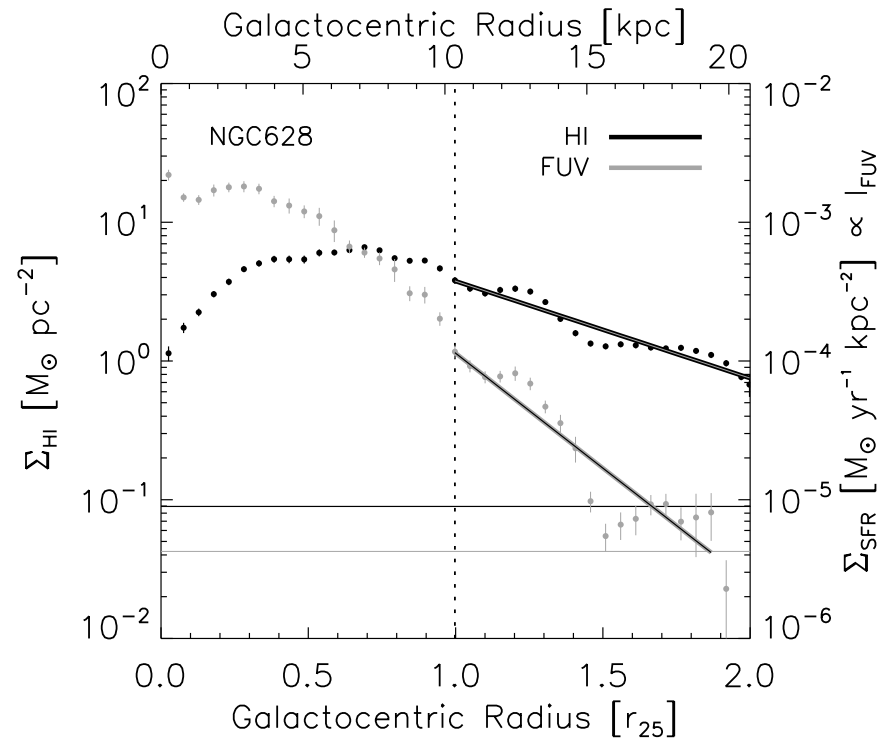

In [12]:
# http://iopscience.iop.org/article/10.1088/0004-6256/140/5/1194/pdf - Bigiel2010
# D-7.3, i-7, PA=20, r25 = 4.9 arcmin, type - Sc
Image('Bigiel2010.png', width=500)

[THE FINE-SCALE STRUCTURE OF THE NEUTRAL INTERSTELLAR MEDIUM IN NEARBY GALAXIES](http://iopscience.iop.org/article/10.1088/0004-6256/141/1/23/pdf) Bagetakos 2011 - изучают HI holes:

> there must be sufficient contrast (at least a 50% drop in
surface brightness) between the hole and its immediate
surroundings & 4. the shape of the hole in pV space must be clearly defined
and adequately described by an ellipse

Также анализируют высоту (средняя - 500 пк ), но там все как обычно по методам. Дыр надено примерно 100

> NGC 628 is a grand-design Sc spiral galaxy located at a
distance of 7.3 Mpc and is seen almost completely face-on.
We detected 104 holes in its H i layer, with diameters ranging
from 0.24 kpc (the resolution limit) to 2 kpc. Only a small
fraction of these holes are type 3 (≈5%). Several supershells
were detected, however four cases (holes number 24, 45, 47,
and 99) are probably superpositions of two or more holes.

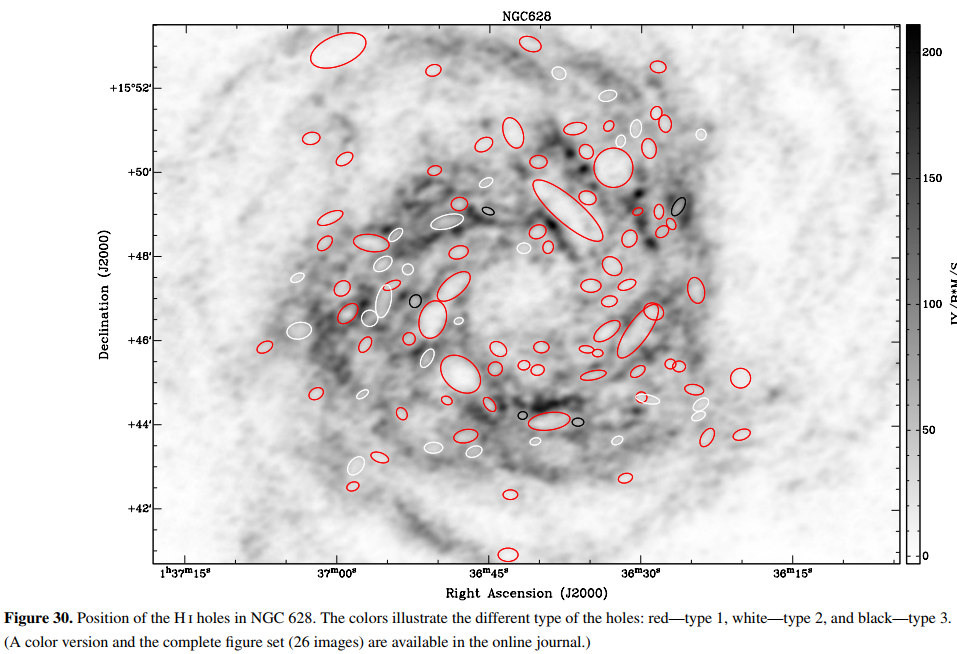

In [16]:
Image('holes.png', width=600)

[A TEST OF STAR FORMATION LAWS IN DISK GALAXIES. II. DEPENDENCE ON DYNAMICAL PROPERTIES](http://iopscience.iop.org/article/10.1088/0004-637X/787/1/68/pdf) Suwannajak 2014 - есть кривая вращения и сравнение 6 законов звездообразования (K-S,Constant Molecular,KM05,KMT09,Gas-Ω, GMC Collision law), которые все неплохо согласуются.

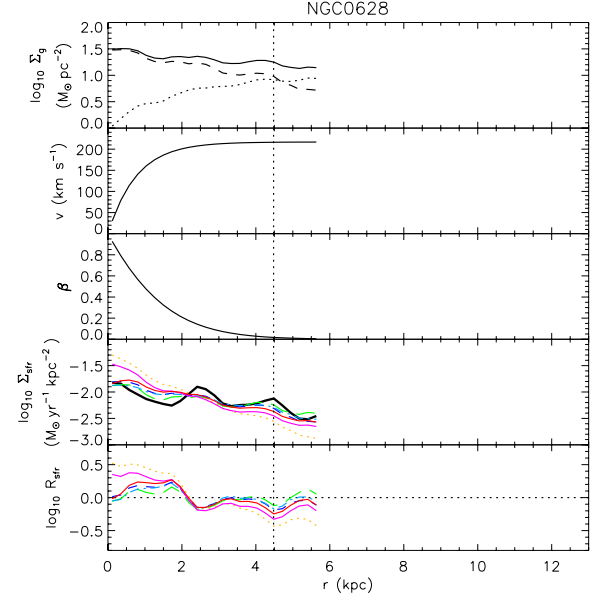

In [17]:
Image('Suwannajak2014.png')

# Данные

In [8]:
# размеры области pix
Ny, Nx = 513, 1553

## Плотность $\Sigma_{\rm HI}$ (THINGS)

Куб данных из THINGS http://www.mpia.de/THINGS/Data.html - дисперсии $\sigma_{HI}$ и плотности $\Sigma_{HI}$.

TODO: про куб - разрешение, почему NA или RO, размеры бима, переводные коэффициенты?, расстояние, H_0 из

http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2563/pdf - масштаб $1.5^{''}/pix$ (а в пк порядка 50 чтоли?)

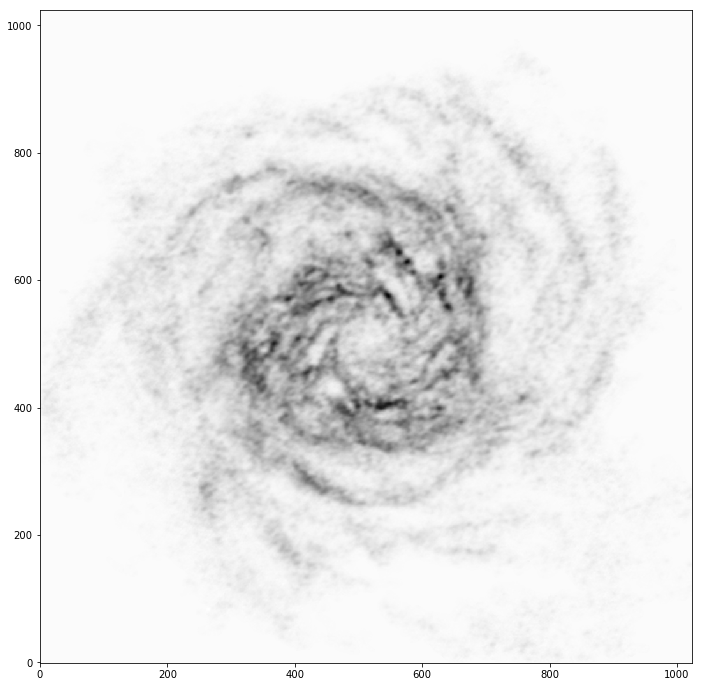

In [11]:
from astropy.io import fits

fig = plt.figure(figsize=[12,12])
data = fits.getdata('NGC_628_NA_MOM0_THINGS.FITS')
plt.imshow(np.squeeze(data), origin='lower', cmap='gist_yarg')
plt.show()

$$\Sigma_{HI} [M_{sun} pc^{-2}] = 0.020 \cos i \times I_{21cm} [K km s^{-1}]$$
из https://arxiv.org/pdf/1609.03179.pdf $$\Sigma_{HI}[M_{sun} {pc}^{-2}] = 8840\times\frac{F_{HI}[Jy / beam \times km/s]}{bmaj\times bmin [arcsec]},$$
where the bmaj and bmin are the major and minor axis size of the beam, respectively. FHI is the flux detected across all velocity channels.

Чтобы перевести в кельвины в Walter написана формула
$$T[K] = 6.07\times 10^5\times S[Jy beam^{-1}]/(B_{maj}\times B_{min}),$$ где $B_{maj},B_{min}$ - размеры бима в секундах

In [13]:
# заменяем nan на 0.
data = np.squeeze(data)
data = np.nan_to_num(data)

Т.к. мы использовал ```NA``` данные - размеры бима 11.88 и 9.30 arcsec

Не знаю почему, но похоже надо переводить beam в пк.

In [15]:
f = lambda l: 6.07*2*1000*cos_i*l/(11.88*9.30*calc_scale(distance)**2 * 1000**2)
Z1 = f(data)

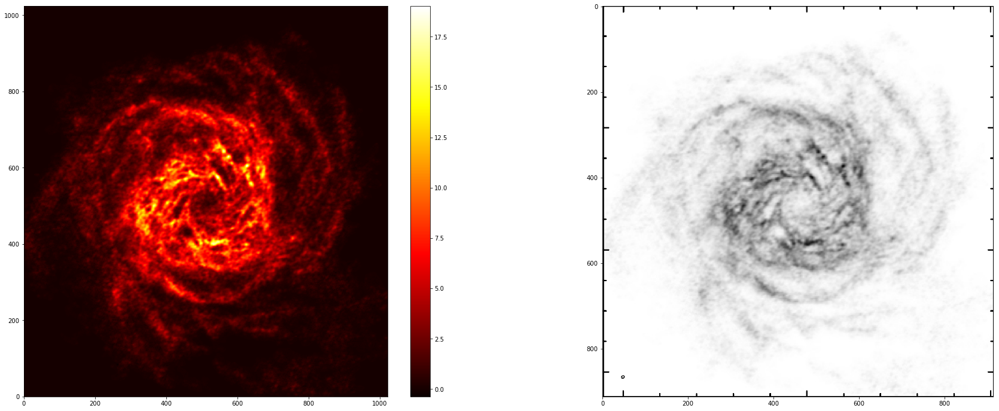

In [16]:
X,Y = np.meshgrid(np.arange(0.,len(data),1), np.arange(0.,len(data[0]),1))
Z = data

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[30, 12])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z1, cmap=cm.hot)
# quadmesh.set_clim(vmin=10., vmax=17.5)

# CS = plt.contour(X, Y, Z, levels=[5000, 10000, 20000])
# plt.clabel(CS, inline=1, fontsize=10)

plt.colorbar()
quadmesh.cmap.set_under('white')

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('THINGS_HI_flux.png'))

In [17]:
Sigma_HI = Z1
np.save('Sigma_HI.npy', Sigma_HI)

Проверка, сравним с данными Лероя:

In [33]:
HI_raw = ImagePIL.open('Leroy_HI_scaled.png')
colorbar = ImagePIL.open('Leroy_HI_colorbar.png')
cw, ch = colorbar.width, colorbar.height
colorbar = np.array(list(colorbar.getdata())).reshape(ch, cw, 4)[:, 10:11, :].reshape(ch, 4)

In [34]:
# 305 px = 9 km/s
305./9

33.888888888888886

In [36]:
print color_to_level((239, 85, 0, 255), colorbar, 862, 1., 33.89)
print color_to_level((255, 255, 255, 255), colorbar, 862, 1., 33.89)
print color_to_level((1, 0, 0, 255), colorbar, 862, 1., 33.89)

10.0
1.0
26.0


In [37]:
%%time
Z = image_map_to_colorbar(HI_raw, colorbar, 33.89, 1.)

Wall time: 53.9 s


In [39]:
X,Y = np.meshgrid(np.arange(0.,HI_raw.width,1), np.arange(0.,HI_raw.height,1))

Cравнение с Лероем:

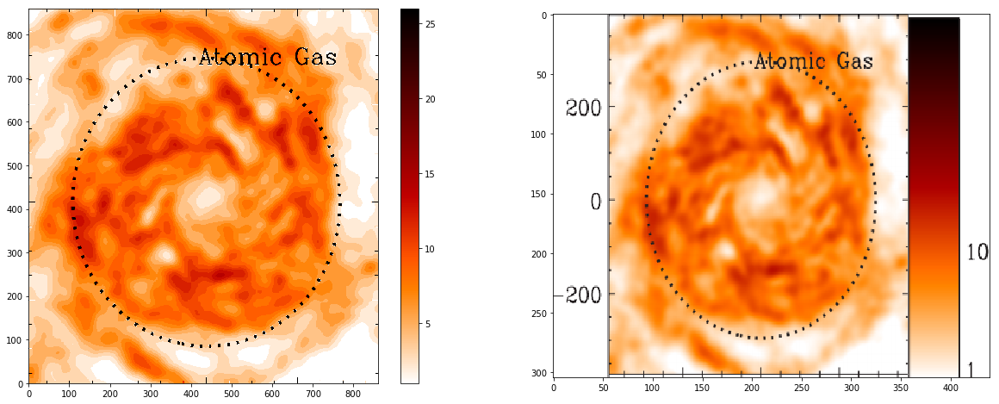

In [40]:
plt.figure(figsize=[20, 8])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_heat_r)
plt.colorbar()

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('Leroy_HI.png'), aspect=1.2);

Сравнение с восстановленным у нас хорошее, проверим еще по верхним областям, огранив снизу: 

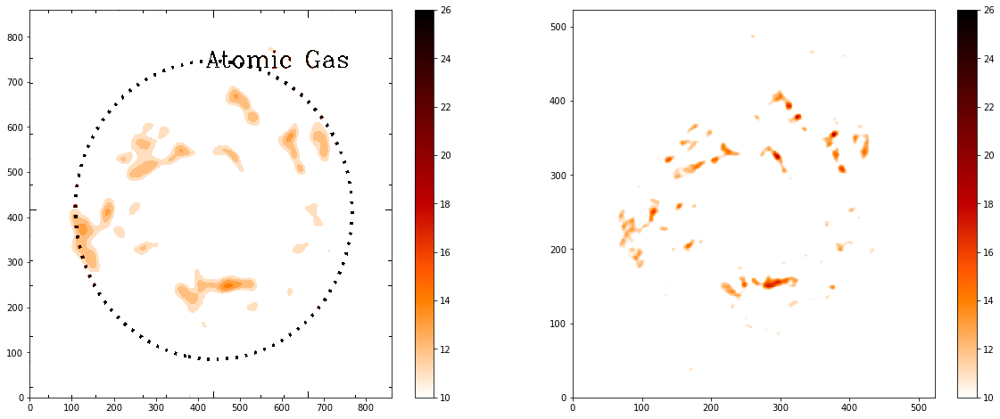

In [41]:
plt.figure(figsize=[20, 8])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=10.0, vmax=26.)
plt.colorbar()

plt.subplot(1, 2, 2)
XX,YY = np.meshgrid(np.arange(0.,len(data)-500,1), np.arange(0.,len(data[0])-500,1))
quadmesh = plt.pcolormesh(XX, YY, Sigma_HI[250:-250, 250:-250], cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=10.0, vmax=26.)
plt.colorbar();

Изменим размер на нужную нам область: (у нас центр 512,512 и масштаб 1.5)

In [49]:
yinterp = np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553)
xinterp = np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513)
Sigma_HI_ = resize_image(Sigma_HI, None, None, yinterp=yinterp, xinterp=xinterp)

resize take 26.93 sec


In [51]:
print min(xinterp), max(xinterp), min(yinterp), max(yinterp)

476.12 548.946666667 394.72 616.866666667


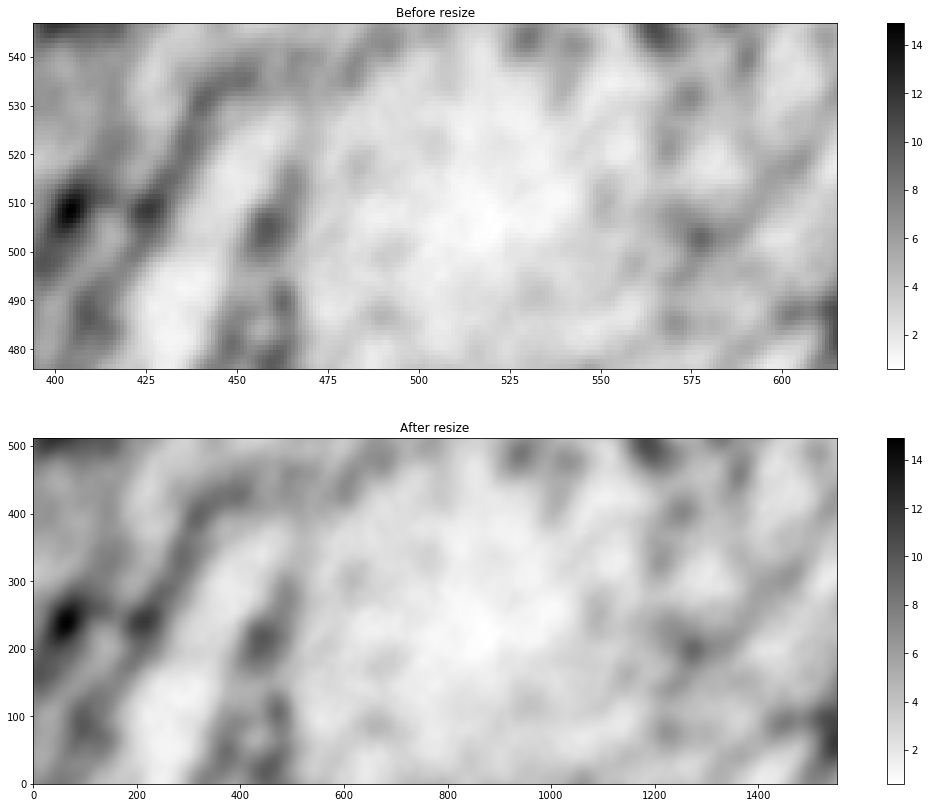

In [58]:
X,Y = np.meshgrid(np.arange(0.,len(Sigma_HI),1), np.arange(0.,len(Sigma_HI[0]),1))
xmi, xma, ymi, yma = int(min(xinterp)), int(max(xinterp)), int(min(yinterp)), int(max(yinterp))
Z = Sigma_HI[xmi:xma, ymi:yma]

plt.figure(figsize=[18, 14])
plt.subplot(2, 1, 1)
quadmesh = plt.pcolormesh(X[xmi:xma, ymi:yma], Y[xmi:xma, ymi:yma], Z, cmap=cm.gist_yarg)
plt.colorbar()
quadmesh.cmap.set_under('white')
plt.title('Before resize')

plt.subplot(2, 1, 2)
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
Z = Sigma_HI_
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
plt.colorbar()
quadmesh.cmap.set_under('white')
plt.title('After resize')

In [59]:
np.save('Sigma_HI_.npy', Sigma_HI_)

## Дисперсии $\sigma_{\rm HI}$ (THINGS)

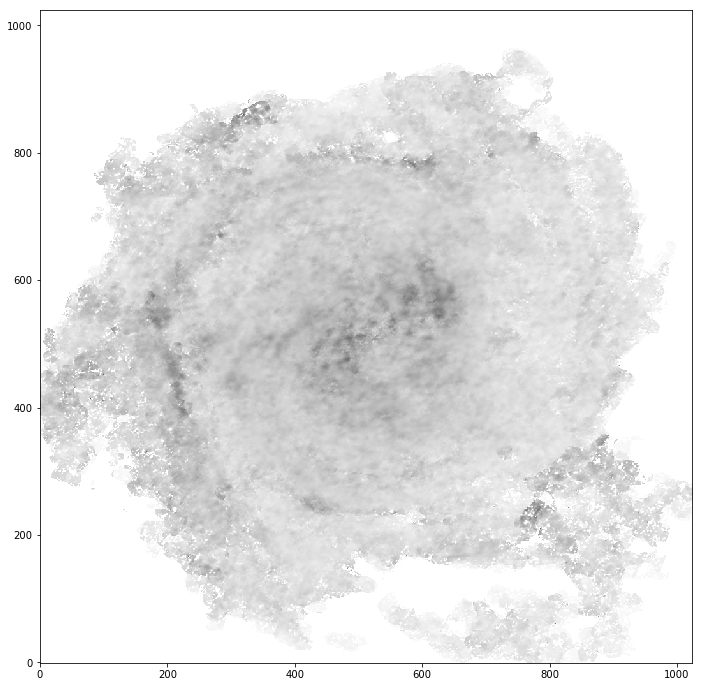

In [62]:
from astropy.io import fits

fig = plt.figure(figsize=[12,12])
data = fits.getdata('NGC_628_NA_MOM2_THINGS.FITS')
plt.imshow(np.squeeze(data), origin='lower', cmap='gist_yarg')
plt.show()

In [63]:
data = np.squeeze(data)
data = np.nan_to_num(data)

C картинкой в статье совпадает (только в ней вроде убраны с малым S/N точки):

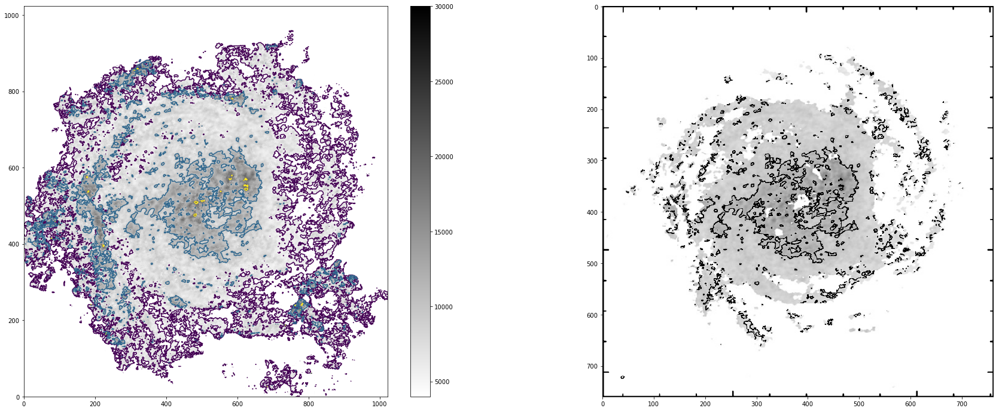

In [67]:
X,Y = np.meshgrid(np.arange(0.,len(data),1), np.arange(0.,len(data[0]),1))
Z = data

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[30, 12])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=4000., vmax=30000.)
plt.colorbar()

CS = plt.contour(X, Y, Z, levels=[5000, 10000, 20000])
quadmesh.cmap.set_under('white')

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('THINGS_HI_disp.png'))

In [68]:
c_g = Z/1000.
np.save('c_g.npy', c_g)

Нужная нам область:

In [69]:
yinterp = np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553)
xinterp = np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513)
c_g_ = resize_image(c_g, None, None, yinterp=yinterp, xinterp=xinterp)

resize take 26.66 sec


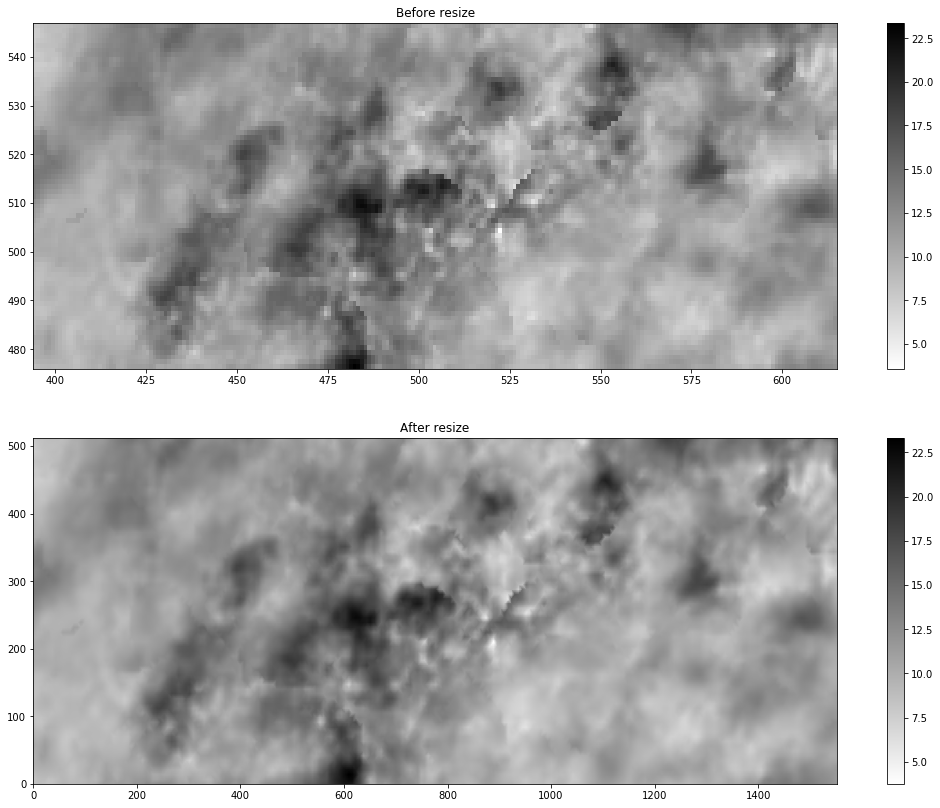

In [70]:
X,Y = np.meshgrid(np.arange(0.,len(Sigma_HI),1), np.arange(0.,len(Sigma_HI[0]),1))
xmi, xma, ymi, yma = int(min(xinterp)), int(max(xinterp)), int(min(yinterp)), int(max(yinterp))
Z = c_g[xmi:xma, ymi:yma]

plt.figure(figsize=[18, 14])
plt.subplot(2, 1, 1)
quadmesh = plt.pcolormesh(X[xmi:xma, ymi:yma], Y[xmi:xma, ymi:yma], Z, cmap=cm.gist_yarg)
plt.colorbar()
quadmesh.cmap.set_under('white')
plt.title('Before resize')

plt.subplot(2, 1, 2)
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
Z = c_g_
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
plt.colorbar()
quadmesh.cmap.set_under('white')
plt.title('After resize')

In [71]:
np.save('c_g_.npy', c_g_)

## Расстояния (THINGS область)

Рассчитаем покоординатно расстояние от центра галактики.

https://physics.stackexchange.com/questions/224950/how-can-i-convert-right-ascension-and-declination-to-distances

In [72]:
from astropy.coordinates import SkyCoord
from astropy import units as u

In [73]:
c = SkyCoord('00h42.5m', '+41d12m')
c2 = SkyCoord('00h43.5m', '+41d13m')
x = c.separation(c2)
print type(x)
print x.arcsec
x

<class 'astropy.coordinates.angles.Angle'>
679.740196405


<Angle 0.18881672122371843 deg>

In [74]:
18/36., 23/29., 22./29 * 2

(0.5, 0.7931034482758621, 1.5172413793103448)

In [75]:
lb = SkyCoord(ra='01h37m35s', dec='+15d34.5m')
rb = SkyCoord('01h35m49.5s', '+15d34.5m')

lu = SkyCoord('01h37m35s', '+16d00m')
ru = SkyCoord('01h35m49.5s', '+16d00m')

In [76]:
print lb.separation(rb).arcsec
print lu.separation(ru).arcsec

1524.39003535
1521.19635036


In [77]:
def pix_to_coordinates(xpix, ypix):
    xrange_ = lb.data.lon.deg + (rb.data.lon.deg-lb.data.lon.deg)/1024. * (xpix)
    yrange_ = lb.data.lat.deg + (lu.data.lat.deg-lb.data.lat.deg)/1024. * (ypix)
    return SkyCoord(ra='{}deg'.format(xrange_), dec='{}deg'.format(yrange_))

In [78]:
pix_to_coordinates(512,512).ra.hms

hms_tuple(h=1.0, m=36.0, s=42.250000008001223)

In [137]:
dist = np.zeros((1024,1024))

In [ ]:
%%time
# 1h34min
center = pix_to_coordinates(512,512)
for xpix in range(1024):
    print xpix
    for ypix in range(1024):
        dist[xpix][ypix] = center.separation(pix_to_coordinates(xpix,ypix)).arcsec

In [188]:
np.save('dist_map.npy', dist)

In [79]:
dist = np.load('dist_map.npy')

Нужная нам область:

In [80]:
yinterp = np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553)
xinterp = np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513)
dist_ = resize_image(dist, None, None, yinterp=yinterp, xinterp=xinterp)

resize take 19.55 sec


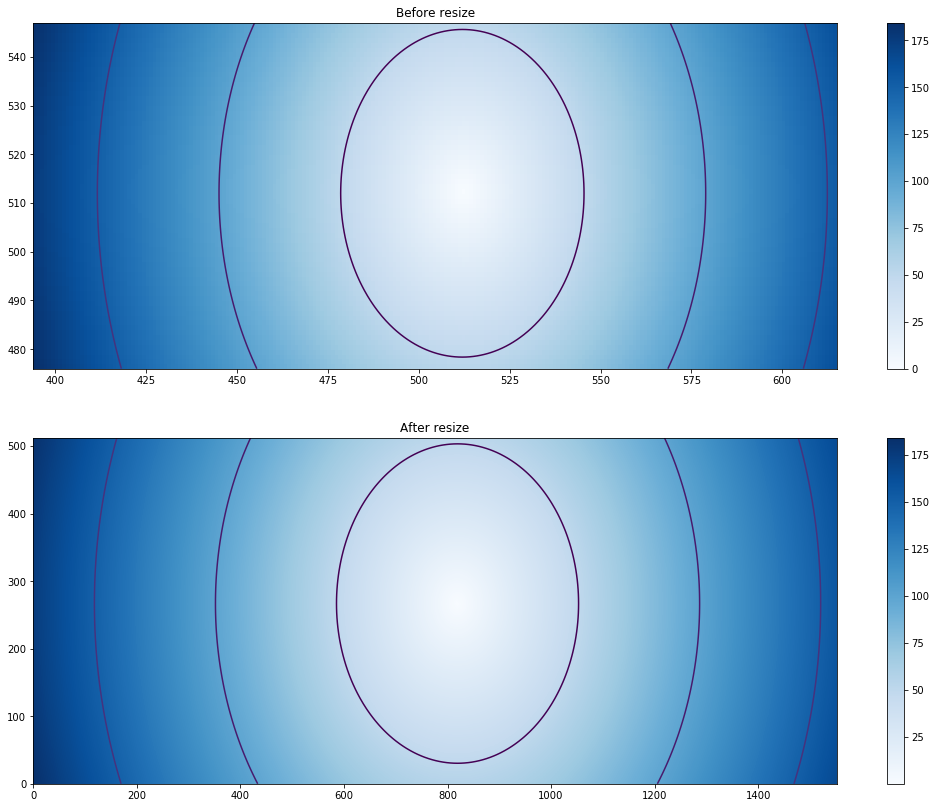

In [88]:
X,Y = np.meshgrid(np.arange(0.,len(Sigma_HI),1), np.arange(0.,len(Sigma_HI[0]),1))
xmi, xma, ymi, yma = int(min(xinterp)), int(max(xinterp)), int(min(yinterp)), int(max(yinterp))
Z = dist[xmi:xma, ymi:yma]

plt.figure(figsize=[18, 14])
plt.subplot(2, 1, 1)
quadmesh = plt.pcolormesh(X[xmi:xma, ymi:yma], Y[xmi:xma, ymi:yma], Z, cmap=cm.Blues)
plt.colorbar()
quadmesh.cmap.set_under('white')
CS = plt.contour(X[xmi:xma, ymi:yma], Y[xmi:xma, ymi:yma], Z, levels=[50, 100, 150, 500, 750])
plt.title('Before resize')

plt.subplot(2, 1, 2)
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
Z = dist_
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.Blues)
plt.colorbar()
quadmesh.cmap.set_under('white')
CS = plt.contour(X, Y, Z, levels=[50, 100, 150, 500, 750])
plt.title('After resize')

In [89]:
np.save('dist_.npy', dist_)

## Кривая вращения и эпициклическая частота

Я разрежу сам руками вдоль большой оси карту скоростей THINGS и сравню ее с литературными.

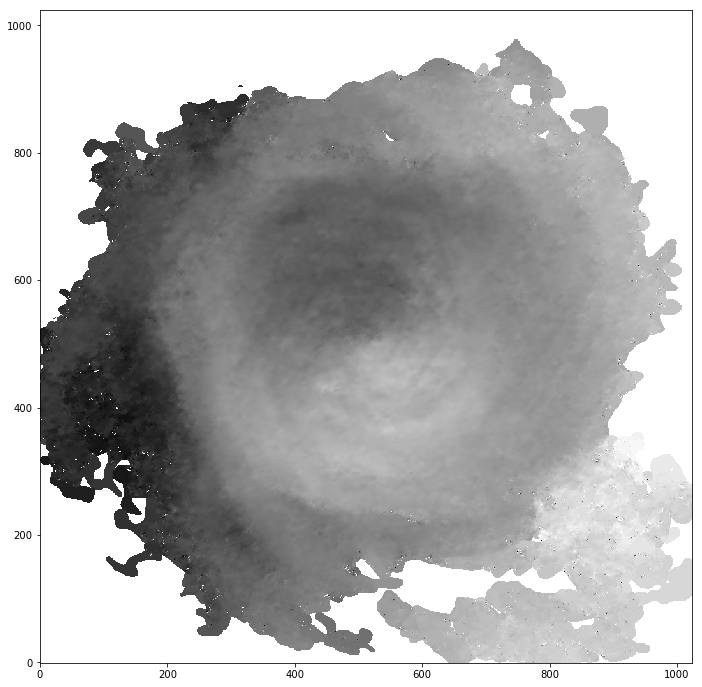

In [133]:
fig = plt.figure(figsize=[12,12])
data = fits.getdata('NGC_628_NA_MOM1_THINGS.FITS')
plt.imshow(np.squeeze(data), origin='lower', cmap='gist_yarg')
plt.show()

In [134]:
data = np.squeeze(data)
data = np.nan_to_num(data)

In [135]:
veloc_norm = lambda l: (l/1000. - 659.1)/sin_i
Z = veloc_norm(data)

In [136]:
v_HI = Z

In [137]:
np.save('v_HI.npy', v_HI)

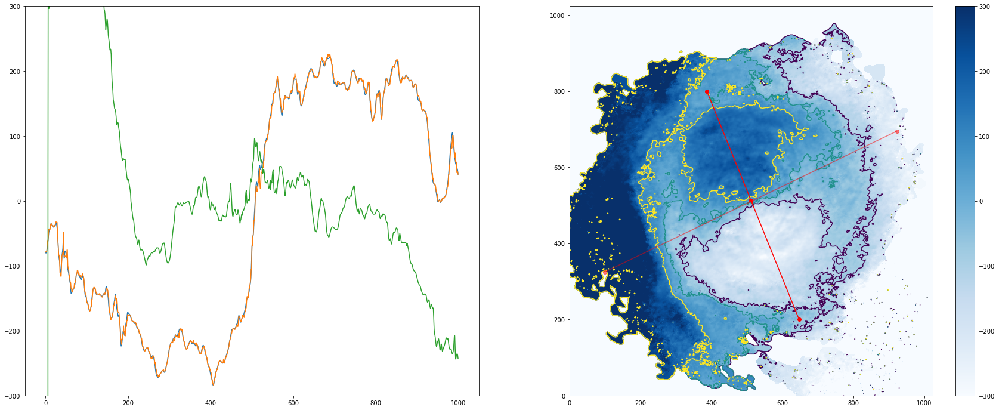

In [138]:
# https://stackoverflow.com/questions/7878398/how-to-extract-an-arbitrary-line-of-values-from-a-numpy-array
import scipy.ndimage

#-- Extract the line...
# Make a line with "num" points...
x0, y0 = 647, 200 # These are in _pixel_ coordinates!!
x1, y1 = 387, 800
num = 1000
x, y = np.linspace(x0, x1, num), np.linspace(y0, y1, num)

# Extract the values along the line, using cubic interpolation
zi = scipy.ndimage.map_coordinates(v_HI, np.vstack((y,x)))
zi_cub = v_HI[y.astype(np.int), x.astype(np.int)]


x0_, y0_ = 100, 325 # These are in _pixel_ coordinates!!
x1_, y1_ = 923, 695
num = 1000
x_, y_ = np.linspace(x0_, x1_, num), np.linspace(y0_, y1_, num)
zi_ = scipy.ndimage.map_coordinates(v_HI, np.vstack((y_,x_)))

#-- Plot...
fig, axes = plt.subplots(ncols=2, figsize = [30, 12])

axes[0].plot(zi)
axes[0].plot(zi_cub)
axes[0].plot(zi_)
axes[0].set_ylim(-300., 300.)
# axes[0].imshow(v_HI)
# axes[1].axis('image')
X,Y = np.meshgrid(np.arange(0.,len(data),1), np.arange(0.,len(data[0]),1))
quadmesh = plt.pcolormesh(X, Y, v_HI, cmap=cm.Blues)
quadmesh.set_clim(vmin=-300., vmax=300.)
plt.colorbar()
# axes[1].imshow(v_HI[::-1, ])
CS = plt.contour(X, Y, v_HI, levels=[-100., 0., 100.])
axes[1].plot([x0, x1], [y0, y1], 'ro-')
axes[1].plot([x0_, x1_], [y0_, y1_], 'ro-', alpha=0.5)
axes[1].scatter([512.,], [512.,], [30.,], marker='s', color='r')
plt.show()

Сделаем, чтобы расстояния примерно соответствовали нужным (потому как на картинке слева - не верна общая длинна):

In [139]:
sqrt((647.-387.)**2 + (200.-800.)**2) * 1520./1024.

970.64959925363905

In [140]:
r_g, vel_g = zip(*sorted(zip(np.abs(np.linspace(0., 970.6, 1000)-970.6/2), np.abs(zi))))

In [146]:
np.save('r_g.npy', r_g)
np.save('vel_g.npy', vel_g)

In [141]:
herrman2009_vc=[0.002107968676327232, 1.8461367775815631,
0.9211823115540909, 6.761771803145308,
2.389733822727237, 12.903726851637828,
4.225071883580966, 20.273481199323243,
5.876314013368969, 26.4139569715517,
7.162877562152744, 33.17277022216879,
8.630023760875005, 38.08396741894032,
9.915181997207867, 43.61202281783639,
11.930400051774697, 48.51878218581564,
12.666081119812134, 52.820517561782935,
14.316620593374722, 58.34561440815084,
16.150553341777538, 64.48461090411519,
18.16577139634434, 69.39137027209442,
19.999001488521742, 74.91498784219823,
22.197612817928857, 80.4356468597739,
23.846746979040518, 84.72998585442076,
25.67927441499249, 89.63822449866407,
27.87648043194868, 93.92812566451867,
29.891698486515494, 98.8348850324979,
32.27089246586111, 102.50792799622789,
34.83418237627244, 107.41024953541485,
36.84729246216288, 110.47087212581249,
39.22789175395938, 115.37467294126353,
42.522646795055536, 120.88645630125467,
45.44991263024566, 124.5550614361924,
49.1100489085715, 130.06388624365536,
53.49954234890582, 134.3360360943409,
56.975582696165915, 138.6155823263469,
60.2675271123603, 141.66584998289593,
63.3760782537144, 144.10221798984853,
67.39948780059358, 147.76194746720174,
70.50803894194767, 150.19831547415433,
73.7992807019166, 152.63320420484285,
75.99297343774562, 153.84621074139486]

In [142]:
leroy2011_vc = [5.327946127946127, 1.941747572815558,
6.6599326599326645, 14.5631067961165,
7.991919191919187, 28.155339805825264,
8.65791245791246, 42.718446601941764,
10.655892255892255, 52.42718446601944,
11.321885521885527, 66.01941747572818,
12.653872053872057, 78.64077669902912,
15.983838383838382, 94.17475728155341,
17.315824915824912, 107.76699029126215,
19.313804713804707, 118.44660194174757,
22.643771043771046, 131.06796116504856,
25.97373737373737, 137.86407766990294,
29.96969696969696, 147.5728155339806,
35.96363636363636, 159.2233009708738,
40.625589225589216, 166.99029126213594,
44.62154882154882, 172.81553398058253,
51.947474747474736, 179.61165048543688,
58.6074074074074, 187.37864077669903,
65.93333333333334, 190.29126213592235,
73.92525252525252, 192.23300970873788,
81.91717171717173, 196.11650485436894,
87.9111111111111, 197.0873786407767,
96.56902356902356, 198.05825242718447,
107.22491582491583, 198.05825242718447,
121.2107744107744, 200.97087378640776,
129.86868686868686, 200,
139.85858585858585, 200,
149.1824915824916, 200,
162.5023569023569, 200,
171.82626262626263, 199.02912621359224,
181.81616161616162, 199.02912621359224,
191.8060606060606, 200,
201.12996632996632, 199.02912621359224,
211.7858585858586, 201.94174757281553,
223.77373737373733, 199.02912621359224,
232.43164983164985, 199.02912621359224,
241.08956228956225, 199.02912621359224,
252.41144781144783, 199.02912621359224,
261.7353535353535, 200,
270.39326599326597, 199.02912621359224,
281.7151515151515, 198.05825242718447,
289.0410774410774, 200]

In [143]:
suwannajak2014_vc = [0.18715761885325177, 30.105909901394284,
0.23961846656211838, 42.149133171496715,
0.2919504178392671, 52.688564738232856,
0.32713914369803954, 63.22369975724507,
0.3966143203935646, 73.76742787170508,
0.4490751681024303, 85.81065114180751,
0.5184214483662384, 94.85058755290123,
0.5707533996433876, 105.39001911963737,
0.6402285763389126, 115.93374723409732,
0.6921738383209095, 121.96180369073448,
0.7956776729897537, 129.5065414939096,
0.8650239532535617, 138.54647790500326,
0.9515134589357461, 147.59071086382096,
1.0204730499044024, 152.11927216481553,
1.124105781004963, 161.16780167135704,
1.210208597391997, 165.7006595200756,
1.3135835356291237, 171.7416056198844,
1.3825431265977786, 176.27016692087903,
1.5374766375217526, 183.82779436722592,
1.675138026595631, 189.87733356248253,
1.7953983973877001, 192.91499280328253,
1.898515542761392, 195.94835549635866,
2.018775913553461, 198.98601473715865,
2.1561795097639056, 202.02797052568263,
2.2764398805559747, 205.06562976648263,
2.4137145803347018, 206.6037938516402,
2.5682614019635226, 209.650046187888,
2.6882639798921577, 209.6801220219553,
2.842681905089261, 211.2225826548368,
2.996970933854648, 211.2612515843519,
3.1513888590517523, 212.8037122172334,
3.30567788781714, 212.84238114674855,
3.4600958130142443, 214.38484177963,
3.631656963629723, 215.93159896023548,
3.7516595415583582, 215.96167479430278,
3.9402350211604977, 216.00893681926573,
4.094524049925885, 216.04760574878088,
4.265956304109648, 216.0905712260199,
4.437646351156847, 219.14112010999162,
4.5919353799222336, 219.17978903950677,
4.746224408687621, 219.21845796902193,
4.831940535779502, 219.23994070764144,
5.003372789963266, 219.28290618488046,
5.140518593310276, 219.3172785666717,
5.311950847494039, 219.3602440439107,
5.449096650841049, 219.39461642570194,
5.603256783174718, 217.92949365185075,
5.706116135684978, 217.95527293819418]

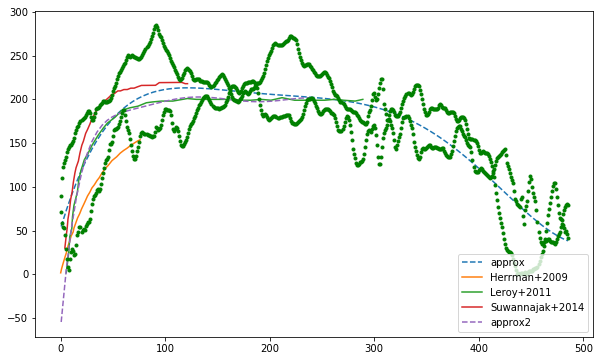

In [144]:
import scipy.interpolate as inter
fig = plt.figure(figsize=[10, 6])
gas_approx = poly1d(polyfit(r_g, vel_g, deg=5))
test_points = np.linspace(min(r_g), max(r_g), 100)
plt.plot(test_points, gas_approx(test_points), '--', label='approx')

plt.plot(herrman2009_vc[0::2], herrman2009_vc[1::2], '-', label='Herrman+2009')
plt.plot(leroy2011_vc[0::2], leroy2011_vc[1::2], '-', label='Leroy+2011')
plt.plot(map(lambda l: l/calc_scale(9.7), suwannajak2014_vc[0::2]), suwannajak2014_vc[1::2], '-', label='Suwannajak+2014')

gas_approx2 = poly1d(polyfit(leroy2011_vc[0::2], leroy2011_vc[1::2], deg=7))
plt.plot(test_points[:-50], gas_approx2(test_points[:-50]), '--', label='approx2')

plt.plot(r_g, vel_g, 'g.')
# plt.ylim(0, 300)
plt.legend(loc='lower right');

Данные хорошо согласуются (похоже, что две работы фитировали только одну сторону кривой) и извлеченный профиль тоже на них похож (отличия есть, но это все не так существенно).

Эпициклическая частота:

$$\kappa=\sqrt{2}\frac{\vartheta_c}{R}\sqrt{1+\frac{R}{\vartheta_c}\frac{d\vartheta_c}{dR}}$$

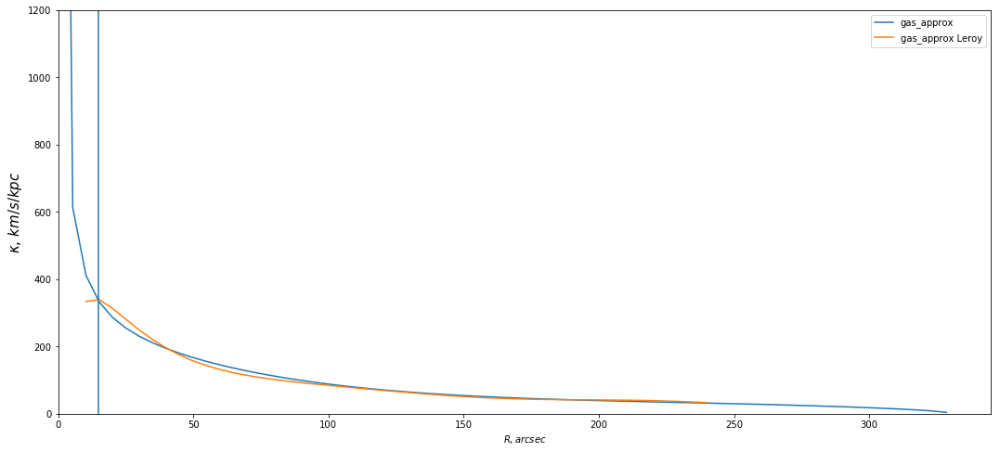

In [145]:
def epicyclicFreq_real(poly_gas, R, resolution):
    '''Честное вычисление эпициклической частоты на расстоянии R для сплайна или полинома'''
    try:
        return sqrt(2.0) * poly_gas(R) * sqrt(1 + R * poly_gas.deriv()(R) / poly_gas(R)) / (R * resolution )
    except:
        return sqrt(2.0) * poly_gas(R) * sqrt(1 + R * poly_gas.derivative()(R) / poly_gas(R)) / (R * resolution )

fig = plt.figure(figsize=[18, 8])
plt.plot(test_points, [epicyclicFreq_real(gas_approx, x, scale) for x in test_points], '-', label='gas_approx')
plt.plot(test_points[2:-50], [epicyclicFreq_real(gas_approx2, x, scale) for x in test_points[2:-50]], '-', label='gas_approx Leroy')

# plt.plot(r_g_dens[1:], ef, '--')
plt.xlabel('$R, arcsec$')
plt.ylabel('$\kappa,\, km/s/kpc$', fontsize=15)
plt.xlim(0)
plt.axvline(x=15.) #bulge
plt.ylim(0, 1200.)
plt.legend()

## SFR (VENGA, H$\alpha$)

Есть картинка Лероя где больше в центре и не удается восстановить из colorbar правильную шкалу и есть JCMT $H_{\alpha}$ изображение, где видно что оно хорошо накладывается на $HI$ картинку 

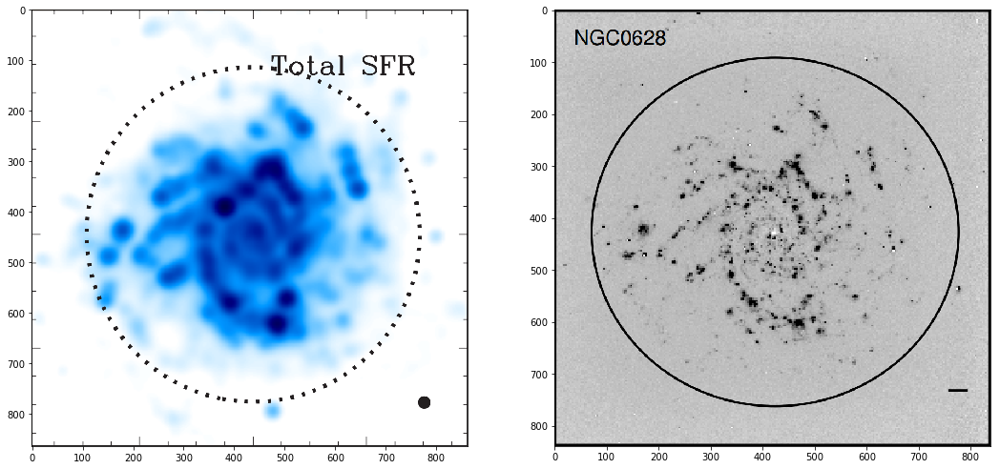

In [12]:
plt.figure(figsize=[18, 10])
plt.subplot(1, 2, 1)
plt.imshow(ImagePIL.open('Leroy_SFR_scaled.png'))

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('JCMT_H_alpha.png'))

Это все хорошо, но мы будем использовать $log(\Sigma_{SFR})$ Dust Corrected H$\alpha$ [$M_{\odot} yr^{-1} kpc^{-1}$] из http://iopscience.iop.org/article/10.1088/0004-637X/764/2/117/pdf.

Сперва уберем точки и лишнее, применим dilation

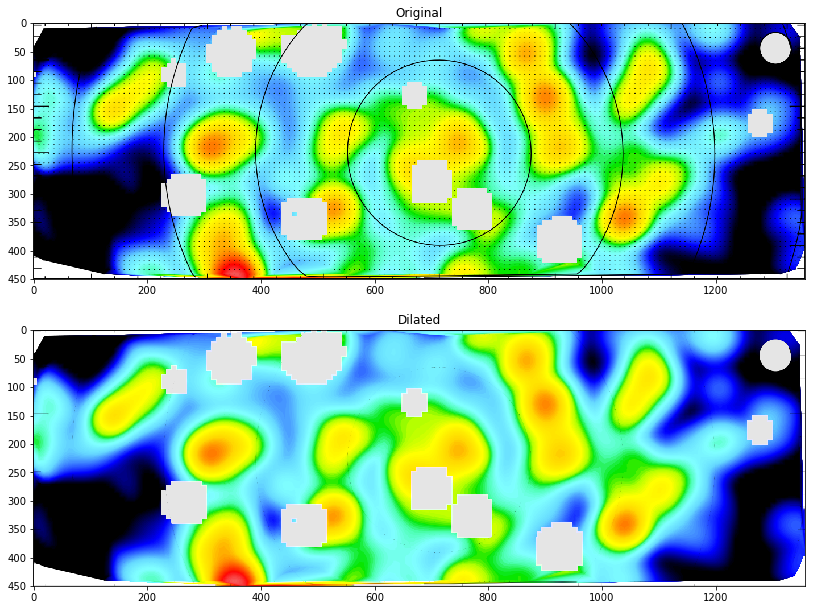

In [66]:
img = cv2.imread('VENGA_Halpha_SFR.png')

kernel = np.ones((3,3), np.uint8) #меньше не сделать

img_dilation = cv2.dilate(img, kernel, iterations=1)

plt.figure(figsize=[24, 16])
plt.subplot(3,1,1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB),cmap=cm.jet)
plt.title('Original')

plt.subplot(3,1,2)
plt.imshow(cv2.cvtColor(img_dilation, cv2.COLOR_BGR2RGB),cmap=cm.jet)
plt.title('Dilated');

Теперь приведем к нужному уровню colorbar:

In [76]:
cv2.cvtColor(img_dilation, cv2.COLOR_BGR2RGB).shape

(450L, 1358L, 3L)

In [160]:
# Halpha_raw = ImagePIL.open('VENGA_Halpha_SFR.png')
Halpha_raw = ImagePIL.fromarray(cv2.cvtColor(img_dilation, cv2.COLOR_BGR2RGB), 'RGB')
colorbar = ImagePIL.open('VENGA_Halpha_SFR_colorbar.png')
cw, ch = colorbar.width, colorbar.height
# colorbar = np.array(list(colorbar.getdata())).reshape(ch, cw, 4)[:, 110:111, :].reshape(ch, 4)
colorbar = np.array(list(colorbar.getdata())).reshape(ch, cw, 4)[:, 110:111, :].reshape(ch, 4)[:, :3]

In [161]:
# 578 px = 2.5
578./2.5, 97./0.42

(231.2, 230.95238095238096)

In [162]:
print color_to_level((0, 0, 252), colorbar, len(colorbar), -3.5, 231.2)
print color_to_level((255, 216, 0), colorbar, len(colorbar), -3.5, 231.2)

-3.07612456747
-1.82179930796


In [163]:
%%time
Z = image_map_to_colorbar(Halpha_raw, colorbar, 231.2, -3.5)

Wall time: 36.2 s


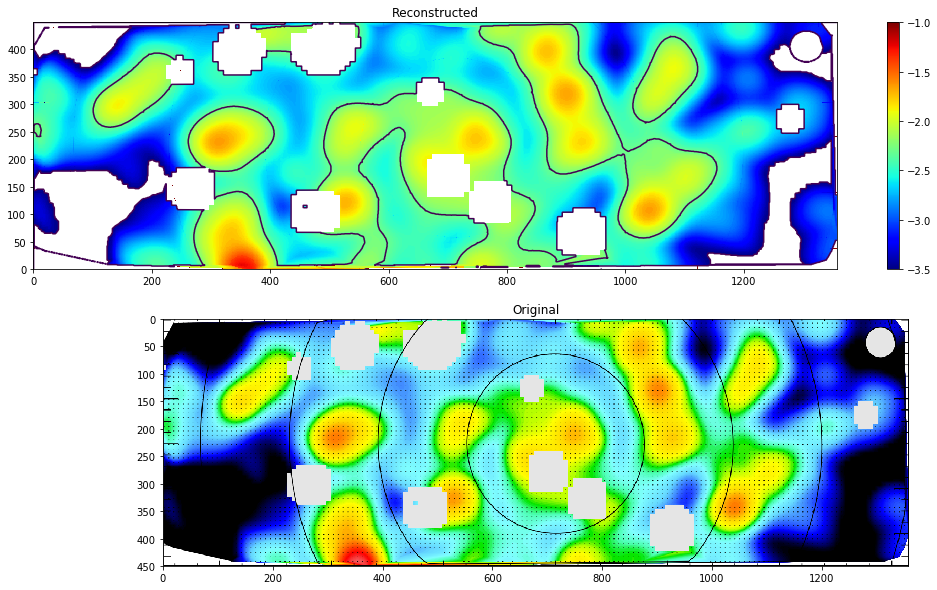

In [164]:
X,Y = np.meshgrid(np.arange(0.,1358,1), np.arange(0.,450,1))

plt.figure(figsize=[18, 10])
plt.subplot(2,1,1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.jet)
quadmesh.set_clim(vmin=-3.5, vmax=-1.0)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
CS = plt.contour(X, Y, Z, levels=[-2.3])
plt.title('Reconstructed')

plt.subplot(2,1,2)
plt.imshow(ImagePIL.open('VENGA_Halpha_SFR.png'))
plt.title('Original');

In [165]:
log_Halpha_SFR = Z

In [166]:
np.save('log_Halpha_SFR.npy', log_Halpha_SFR)

И пережать в нужный размер:

In [167]:
yinterp = np.linspace(0, 1358., 1553)
xinterp = np.linspace(0., 450., 513)
log_Halpha_SFR_ = resize_image(log_Halpha_SFR, None, None, xinterp=xinterp, yinterp=yinterp)

450 1358
resize take 12.73 sec


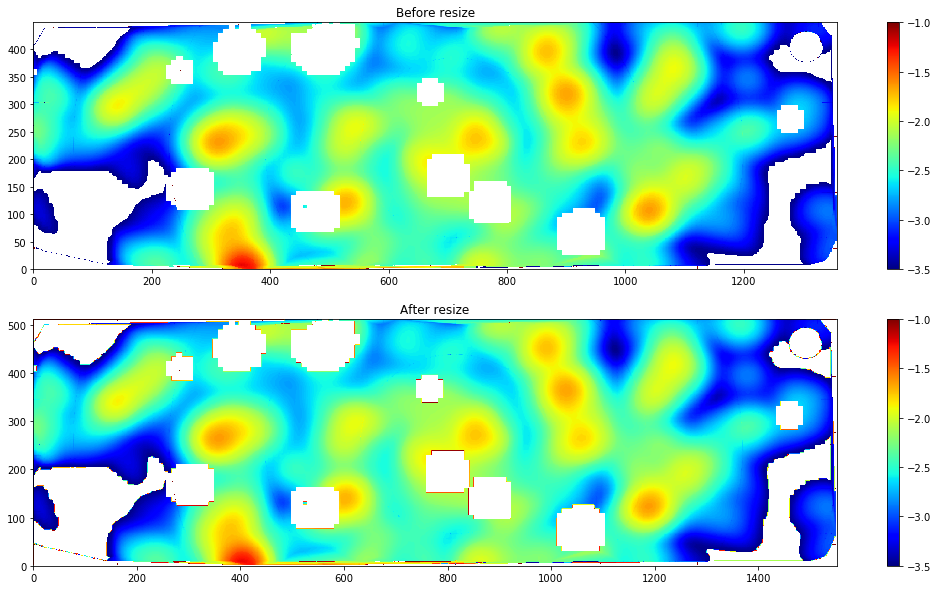

In [169]:
plt.figure(figsize=[18, 10])

plt.subplot(2, 1, 1)
X,Y = np.meshgrid(np.arange(0.,1358,1), np.arange(0.,450,1))
Z = log_Halpha_SFR
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.jet)
quadmesh.set_clim(vmin=-3.5, vmax=-1.0)
plt.colorbar()
quadmesh.cmap.set_under('white')
plt.title('Before resize')

plt.subplot(2, 1, 2)
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
Z = log_Halpha_SFR_
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.jet)
quadmesh.set_clim(vmin=-3.5, vmax=-1.0)
plt.colorbar()
quadmesh.cmap.set_under('white')
plt.title('After resize');

In [170]:
np.save('log_Halpha_SFR_.npy', log_Halpha_SFR_)

Контуры:

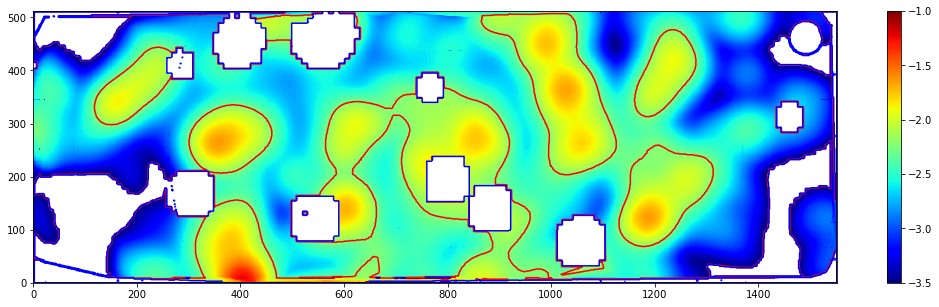

In [11]:
def add_SFR_contours(levels=[-2.25, -1.], colors=('red', 'blue'), X=None, Y=None):
#     X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
    if X is None and Y is None:
        X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
    CS = plt.contour(X, Y, log_Halpha_SFR_, levels=levels, colors=colors)
    CS3 = plt.contourf(X, Y, log_Halpha_SFR_, [-1., -0.8], colors=('white'))
    
plt.figure(figsize=[18, 5])
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
quadmesh = plt.pcolormesh(X, Y, log_Halpha_SFR_, cmap=cm.jet)
quadmesh.set_clim(vmin=-3.5, vmax=-1.0)
plt.colorbar()
add_SFR_contours()

## Плотность $\Sigma_{\rm CO}$ (VENGA, HERACLES)

В http://iopscience.iop.org/article/10.1088/0004-637X/764/2/117/pdf выбор из трех возможностей:

* HERACLES, CO(2–1) beam size of $13.6$ and rms noise of ∼22 mK per 2.6 km s−1 channel, which translates into a 1σ limit on the molecular gas surface density of $\Sigma_{H2}\approx 3 M_{\odot} pc^{-2}$
* BIMA-SONG, robust beam size of $6.2$, and rms noise of 51 mJy beam−1 in a 10 km s−1 channel or $\Sigma_{H2}\approx 13 M_{\odot} pc^{-2}$
* CARMA, CO(1–0) has a spatial resolution of $3.6$ and rms noise of ∼20 mJy beam−1 in a 10 km s−1 channel $\Sigma_{H2}\approx 5 M_{\odot} pc^{-2}$

Т.о. лучше HERACLES, поскольку в смысле пространственного разрешения они все приведены к одному
>We
convolve the BIMA-SONG and CARMA maps with a Gaussian
kernel to match the 13.6 arcsec PSF of the HERACLES map, which
corresponds to ∼570 pc at the assumed distance to NGC 0628.

TODO: учесть градиент $X_{CO}$, посмотреть как влияет на результат

Как и с SFR, cперва уберем точки и лишнее, применим dilation

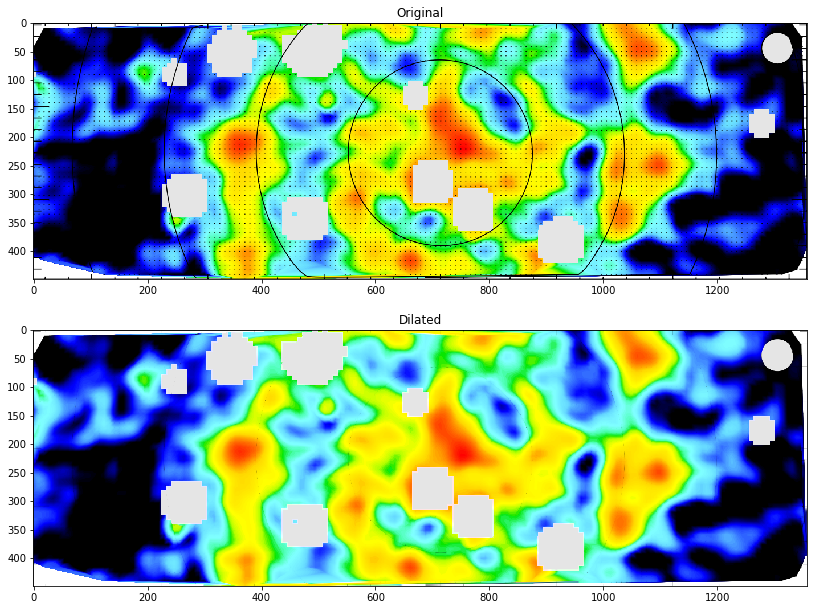

In [174]:
img = cv2.imread('VENGA_HERACLES_CO.png')

kernel = np.ones((3,3), np.uint8) #меньше не сделать

img_dilation = cv2.dilate(img, kernel, iterations=1)

plt.figure(figsize=[24, 16])
plt.subplot(3,1,1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB),cmap=cm.jet)
plt.title('Original')

plt.subplot(3,1,2)
plt.imshow(cv2.cvtColor(img_dilation, cv2.COLOR_BGR2RGB),cmap=cm.jet)
plt.title('Dilated');

Теперь приведем к нужному уровню используя colorbar:

In [176]:
CO_raw = ImagePIL.fromarray(cv2.cvtColor(img_dilation, cv2.COLOR_BGR2RGB), 'RGB')
colorbar = ImagePIL.open('VENGA_BIMA_CO_colorbar.png')
cw, ch = colorbar.width, colorbar.height
colorbar = np.array(list(colorbar.getdata())).reshape(ch, cw, 4)[:, 110:111, :].reshape(ch, 4)[:, :3]

In [177]:
# 388 px = 0.8
388./0.8

485.0

In [178]:
print color_to_level((3, 230, 80), colorbar, len(colorbar), 0., 485.)
print color_to_level([118, 118, 118], colorbar, len(colorbar), 0., 485.)
print color_to_level([0, 0, 0], colorbar, len(colorbar), 0., 485.)
print color_to_level((3, 230, 80), colorbar, len(colorbar), 0., 485.)
print color_to_level([178, 178, 178], colorbar, len(colorbar), 0., 485.)

0.583505154639
1.19381443299
0.00412371134021
0.583505154639
1.19381443299


In [179]:
%%time
Z = image_map_to_colorbar(CO_raw, colorbar, 485., 0.)

Wall time: 41.1 s


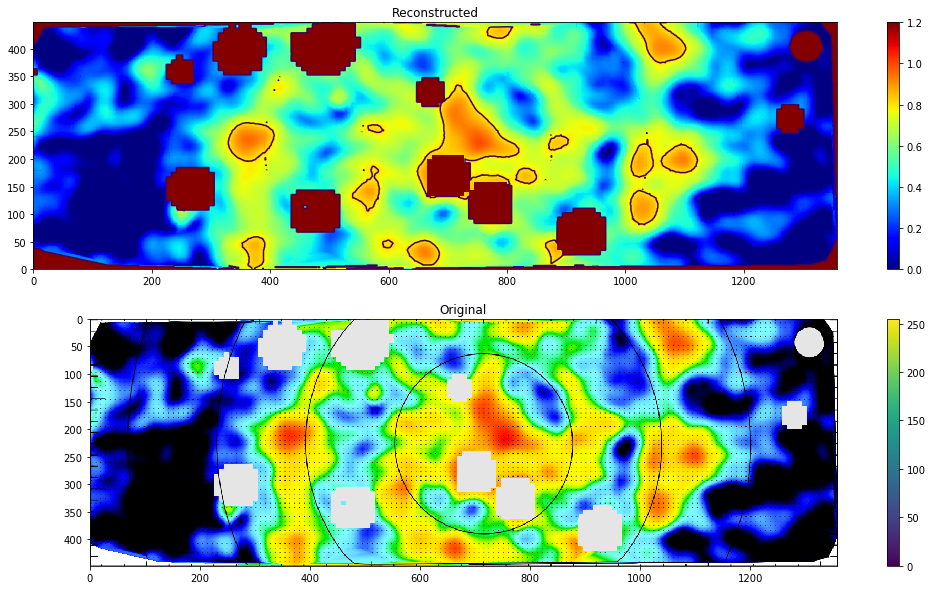

In [194]:
X,Y = np.meshgrid(np.arange(0.,1358,1), np.arange(0.,449,1))

fig = plt.figure(figsize=[18, 10])
plt.subplot(2,1,1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.jet)
quadmesh.set_clim(vmin=0., vmax=1.2)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
CS = plt.contour(X, Y, Z, levels=[0.8])
plt.title('Reconstructed')

plt.subplot(2,1,2)
cax = plt.imshow(ImagePIL.open('VENGA_HERACLES_CO.png'))
cbar = fig.colorbar(cax)
plt.title('Original');

In [195]:
log_HERACLES_CO = Z

In [196]:
np.save('log_HERACLES_CO.npy', log_HERACLES_CO)

И пережать в нужный размер:

In [197]:
# yinterp = np.linspace(0, 1358., 1553)
# xinterp = np.linspace(0., 450., 513)
log_HERACLES_CO_ = resize_image(log_HERACLES_CO, Nx, Ny)

449 1358
resize take 11.71 sec


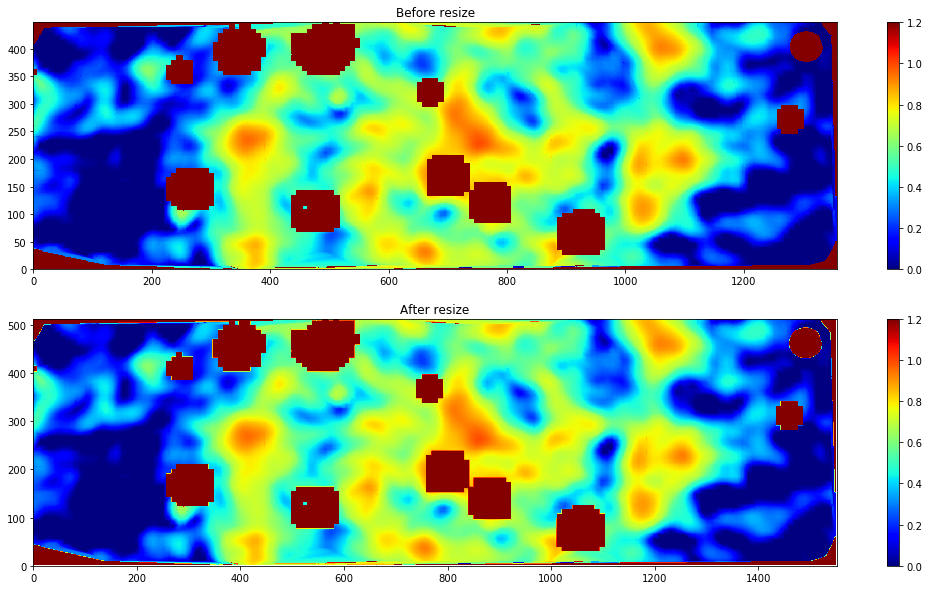

In [198]:
plt.figure(figsize=[18, 10])

plt.subplot(2, 1, 1)
X,Y = np.meshgrid(np.arange(0.,1358,1), np.arange(0.,449,1))
Z = log_HERACLES_CO
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.jet)
quadmesh.set_clim(vmin=0., vmax=1.2)
plt.colorbar()
quadmesh.cmap.set_under('white')
plt.title('Before resize')

plt.subplot(2, 1, 2)
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
Z = log_HERACLES_CO_
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.jet)
quadmesh.set_clim(vmin=0., vmax=1.2)
plt.colorbar()
quadmesh.cmap.set_under('white')
plt.title('After resize');

In [199]:
np.save('log_HERACLES_CO_.npy', log_HERACLES_CO_)

Теперь поверхностные плотности. 

Leroy делал $$\Sigma_{H_2} = 4.4\cos i \times I_{CO(1-0)}$$ $$\Sigma_{H_2} = 5.5\cos i \times I_{CO(2-1)}$$ для $X_{CO}=2\times10^{20}$

У нас $CO(2-1)$ изначально, но карта уже переведена в $CO(1-0)$, так что используем первую формулу. Учтем, что у нас логарифм.

In [213]:
HERACLES_CO_ = np.power(10., log_HERACLES_CO_)*(4.4*cos_i)

In [217]:
np.save('HERACLES_CO_.npy', HERACLES_CO_)

Сравним с картинкой Leroy (2008):

In [214]:
H2_raw = ImagePIL.open('Leroy_H2_scaled.png')
colorbar = ImagePIL.open('Leroy_HI_colorbar.png')
cw, ch = colorbar.width, colorbar.height
colorbar = np.array(list(colorbar.getdata())).reshape(ch, cw, 4)[:, 10:11, :].reshape(ch, 4)

In [215]:
%%time
Z = image_map_to_colorbar(H2_raw, colorbar, 33.89, 1.)

Wall time: 55 s


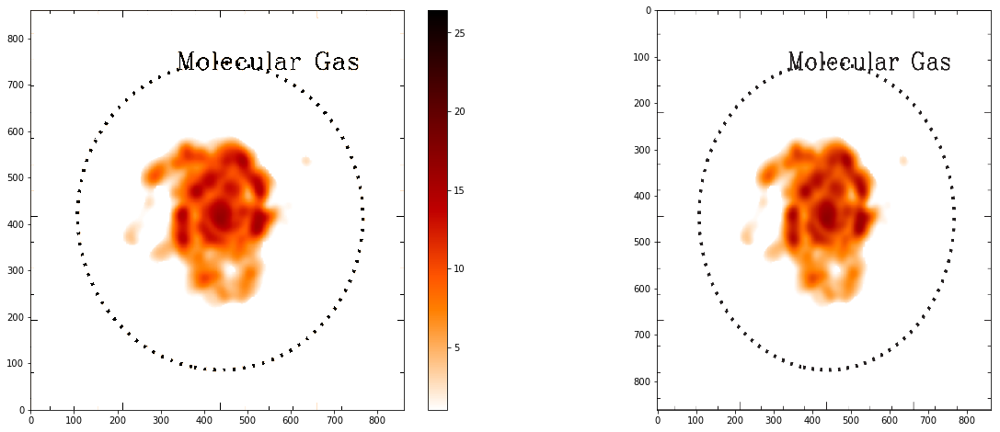

In [216]:
X,Y = np.meshgrid(np.arange(0.,862,1), np.arange(0.,862,1))

plt.figure(figsize=[20, 8])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_heat_r)
# quadmesh.set_clim(vmin=10.0, vmax=26.)
plt.colorbar()

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('Leroy_H2_scaled.png'), aspect=1.2);

Сравнение с данными VENGA:

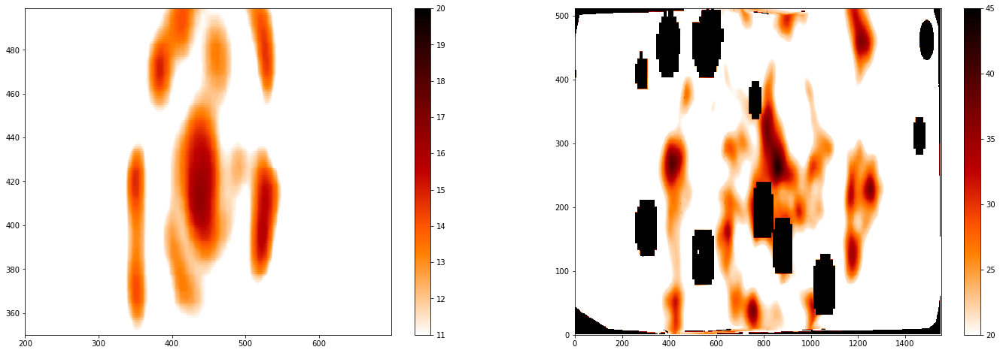

In [228]:
plt.figure(figsize=[24, 8])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X[350:500, 200:700], Y[350:500, 200:700], Z[350:500, 200:700], cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=11.0, vmax=20.)
plt.colorbar()

plt.subplot(1, 2, 2)
XX,YY = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
quadmesh = plt.pcolormesh(XX, YY, HERACLES_CO_, cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=20.0, vmax=45.)
plt.colorbar();

Видно, что разница примерно в два раза по оценкам - что-то Leroy сделал не так в своей работе, поскольку позже в [Leroy 2015](http://iopscience.iop.org/article/10.1088/0004-637X/808/1/99/pdf) плотности уже до 40 $M_{\odot}pc^{-2}$ (может ли это быть связано с разрешением?)

Контуры:

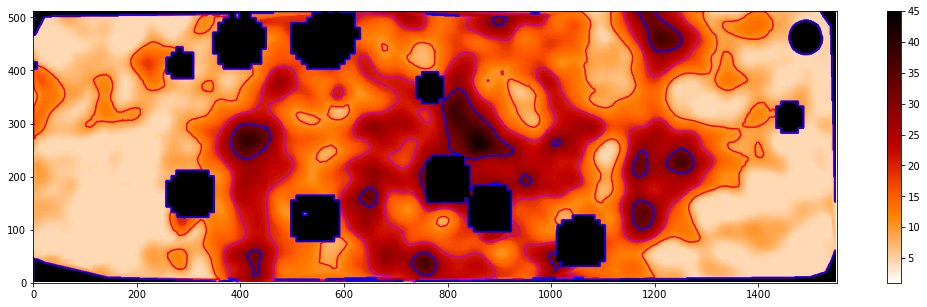

In [287]:
def add_CO_contours(levels=[10., 20., 30.], colors=('red', 'm', 'b'), X=None, Y=None):
    if X is None and Y is None:
        X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
    CS = plt.contour(X, Y, HERACLES_CO_, levels=levels, colors=colors)
    
plt.figure(figsize=[18, 5])
quadmesh = plt.pcolormesh(XX, YY, HERACLES_CO_, cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=1.0, vmax=45.)
plt.colorbar()
add_CO_contours();

## Плотность $\Sigma_{\rm s}$ (S4G)

другая возможность - использовать cleaned stellar fits из http://irsa.ipac.caltech.edu/data/SPITZER/S4G/docs/P5_README.html чтобы восстановить с помощью работы [Querejeta et al. (2014)](https://ui.adsabs.harvard.edu/#abs/2014ASPC..486..143Q/abstract)

Используем ровно ту методику, что Leroy применил в своей работе к S4G данным: $$\Sigma_s = 280\cos i\times I_{3.6}$$

TODO: проверить, что именно к ним, добавить разрешение кубов, размеры бима

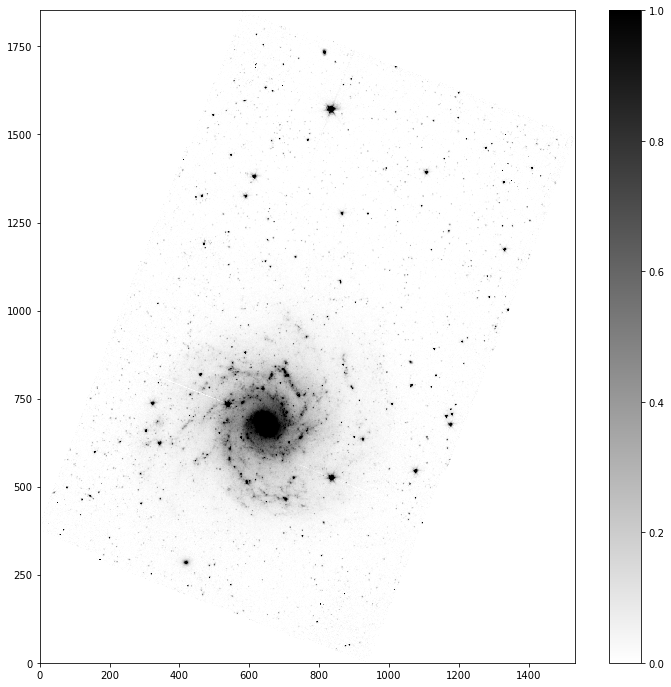

In [9]:
data = fits.getdata('NGC0628.phot.1_nonan.fits')
data = squeeze(data)
X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))
Z = data

plt.figure(figsize=[12, 12])
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=0., vmax=1.)

plt.colorbar()

In [10]:
hdulist = fits.open('NGC0628.phot.1_nonan.fits')
# hdulist[0].header
# PXSCAL1 =    -1.22334117768332 / [arcsec/pix] Scale for axis 1 at CRPIX1,CRPIX2 
# PXSCAL2 =     1.22328355209902 / [arcsec/pix] Scale for axis 2 at CRPIX1,CRPIX2 

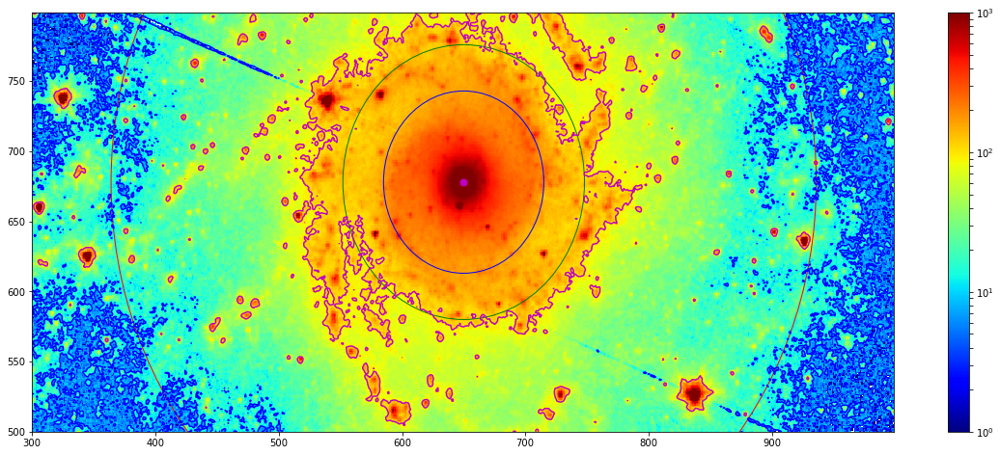

In [11]:
# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[20, 8])
quadmesh = plt.pcolormesh(X[500:800, 300:1000], Y[500:800, 300:1000], Z[500:800, 300:1000]*280.*cos_i, cmap=cm.jet, norm=matplotlib.colors.LogNorm())
quadmesh.set_clim(vmin=1., vmax=1000.)
plt.colorbar()

# plt.plot([650, 715],[678,678],'-', lw=5)
# plt.plot([650, round(650+65*1.5)],[678,678],'-', lw=4, color='g')
# plt.plot([650, round(650+65*4.4)],[678,678],'-', lw=2, color='r')

plt.scatter([650.], [678.], [50.], marker='o', color='m')

circle = plt.Circle((650, 678), 715.-650., color='b', fill=False)
plt.gca().add_artist(circle)
circle = plt.Circle((650, 678), round(650+65*1.5)-650., color='g', fill=False)
plt.gca().add_artist(circle)
circle = plt.Circle((650, 678), round(650+65*4.4)-650., color='r', fill=False)
plt.gca().add_artist(circle)


CS = plt.contour(X[500:800, 300:1000], Y[500:800, 300:1000], Z[500:800, 300:1000]*280.*cos_i, levels=[10., 100.], colors=('blue', 'm'));
# plt.clabel(CS, inline=1, fontsize=10)

# quadmesh.cmap.set_over('white')

Оооооочень похоже на его усредненные радиальные данные.

In [12]:
Sigma_s_Leroy = Z*280.*cos_i

In [13]:
np.save('Sigma_s_Leroy.npy', Sigma_s_Leroy)

Теперь нужно вырезать соответствующий прямоугольник:

In [14]:
# venga (59, 413)   (458, 1112)
# s4g  (104, 338)    (262, 563)

(458.-59.)/(262.-104.), (1112.-413.)/(563.-338.), 65/50.

(2.5253164556962027, 3.1066666666666665, 1.3)

In [15]:
scalex = 1./1.23
scaley = 1./1.35

# scalex = 0.41671419*2.5
# scaley = 0.21104176*2.5
# scalex = 1./1.3
# scaley = 1./1.3

# TODO: понять почему такие, сейчас они эмпирически подобранные

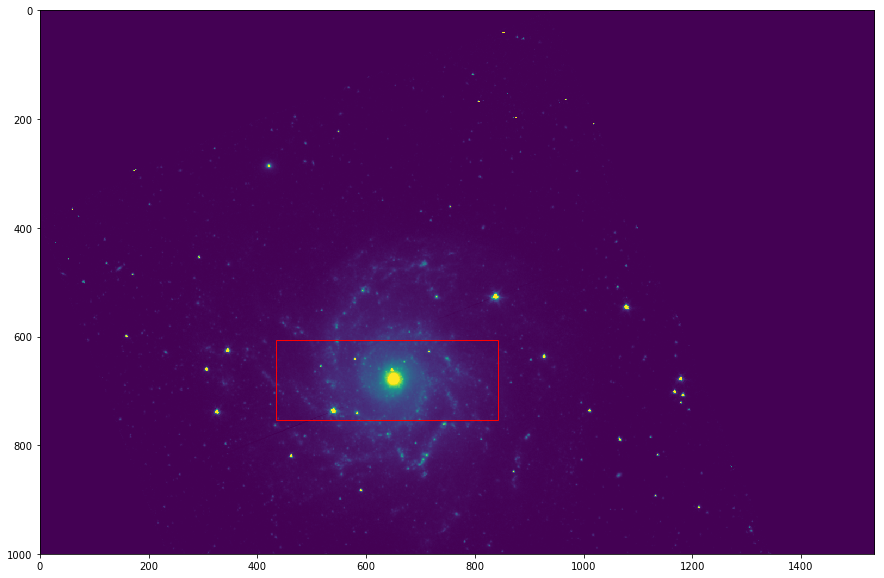

In [16]:
plt.figure(figsize=[20, 10])
plt.imshow(Sigma_s_Leroy[0:1000, :], vmin=1, vmax=1000)

rect = patches.Rectangle((650. - 175.92/scalex, 678. - 53.82/scaley), 157.3/scalex+175.92/scalex, 53.82/scaley + 55.42/scaley, linewidth=1,edgecolor='r',facecolor='none')
plt.gca().add_patch(rect);

Перемасштабирование:

In [17]:
# именно так, не наоборот!
yinterp = np.linspace(650. - 175.92/scalex, 650.+157.3/scalex, 1553)
xinterp = np.linspace(678. - 53.82/scaley, 678. + 55.42/scaley, 513)

Sigma_s_Leroy_ = resize_image(Sigma_s_Leroy[::-1, :], None, None, xinterp=xinterp, yinterp=yinterp)

resize take 1022.78 sec


Неплохо согласуется с VENGA $r$:

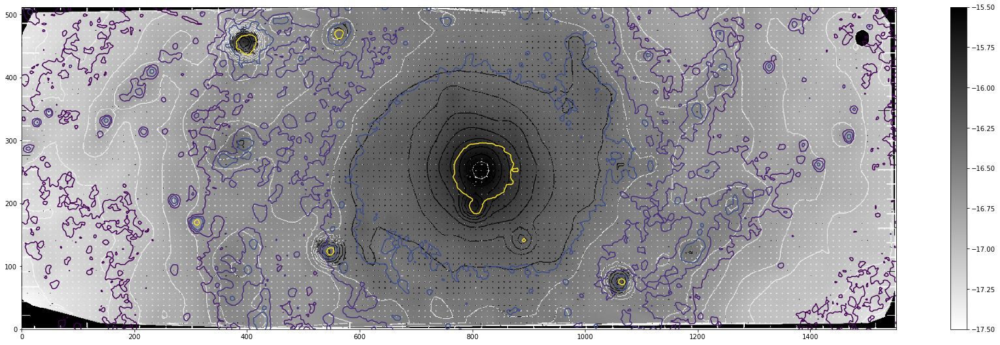

In [18]:
plt.figure(figsize=[30, 20])
plt.subplot(2, 1, 1)

log_fR_ = np.load('log_fR_.npy')

X,Y = np.meshgrid(np.arange(0.,1553,1), np.arange(0.,513,1))
quadmesh = plt.pcolormesh(X, Y, log_fR_, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, log_fR, levels=[5., 10., 20.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=-17.5, vmax=-15.5)
plt.colorbar()

CS = plt.contour(X, Y, Sigma_s_Leroy_[::-1, :], levels=[30., 90., 130., 210., 800.], aspect='auto')
# plt.clabel(CS, inline=1, fontsize=10)

In [19]:
np.save('Sigma_s_Leroy_.npy', Sigma_s_Leroy_[::-1, :])

## Дисперсии $\sigma_{\rm s}$ (VENGA)

$$\sigma^2_{los, \phi} = [\sigma_R^2\sin^2\phi + \sigma^2_{\varphi}\cos^2\phi]\sin^2 i + \sigma_z^2\cos^2 i,$$ where $\phi$ is the angle between the slit and the major axis of the
projected stellar disc (the position angle).

TODO: разрешение куба в пространственном и по скоростям 

Как и с SFR, cперва уберем точки и лишнее, применим dilation

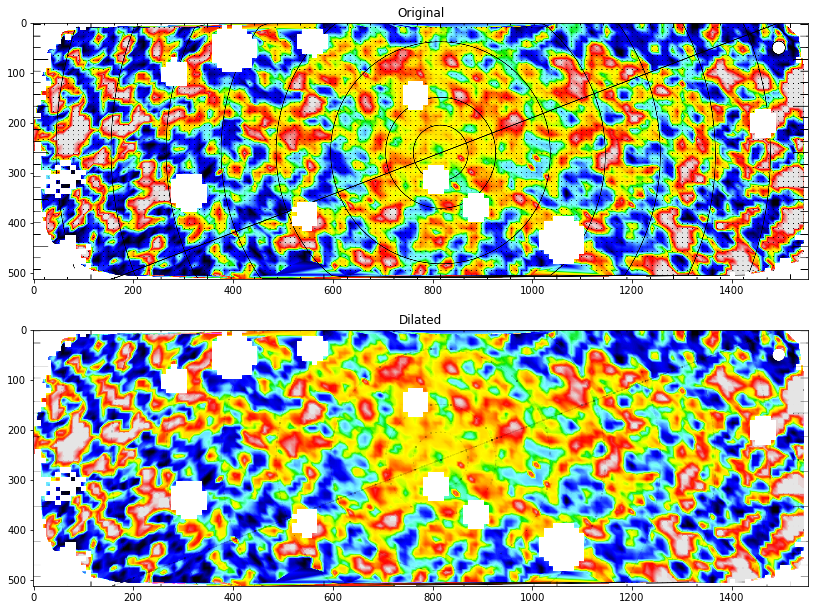

In [105]:
img = cv2.imread('VENGA_sig_los.png')

kernel = np.ones((3,3), np.uint8) #меньше не сделать

img_dilation = cv2.dilate(img, kernel, iterations=1)
img_dilation = cv2.erode(img_dilation, kernel, iterations=1) #erode сделает картинку менее красивой, но не будут появляться артефакты на границе областей

plt.figure(figsize=[28, 16])
plt.subplot(3,1,1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB),cmap=cm.jet)
plt.title('Original')

plt.subplot(3,1,2)
plt.imshow(cv2.cvtColor(img_dilation, cv2.COLOR_BGR2RGB),cmap=cm.jet)
plt.title('Dilated');

Теперь приведем к нужному уровню используя colorbar:

In [106]:
sig_raw = ImagePIL.fromarray(cv2.cvtColor(img_dilation, cv2.COLOR_BGR2RGB), 'RGB')
colorbar = ImagePIL.open('VENGA_sig_los_colorbar.png')
cw, ch = colorbar.width, colorbar.height
colorbar = np.array(list(colorbar.getdata())).reshape(ch, cw, 4)[:, 110:111, :].reshape(ch, 4)[:, :3]

In [107]:
# 110 px = 12.33 km/s
110./12.33

8.921330089213301

In [108]:
print color_to_level((102, 215, 255), colorbar, len(colorbar), 6., 8.921330089213301)
print color_to_level((0, 1, 252), colorbar, len(colorbar), 6., 8.921330089213301)
print color_to_level((12, 12, 14), colorbar, len(colorbar), 6., 8.921330089213301)
print color_to_level((255, 255, 255), colorbar, len(colorbar), 6., 8.921330089213301)
print color_to_level((229, 229, 229), colorbar, len(colorbar), 6., 8.921330089213301)

31.3325454545
18.4420909091
6.33627272727
80.3162727273
80.3162727273


In [110]:
%%time
Z = image_map_to_colorbar(sig_raw, colorbar, 8.921330089213301, 6.)

Wall time: 48.3 s


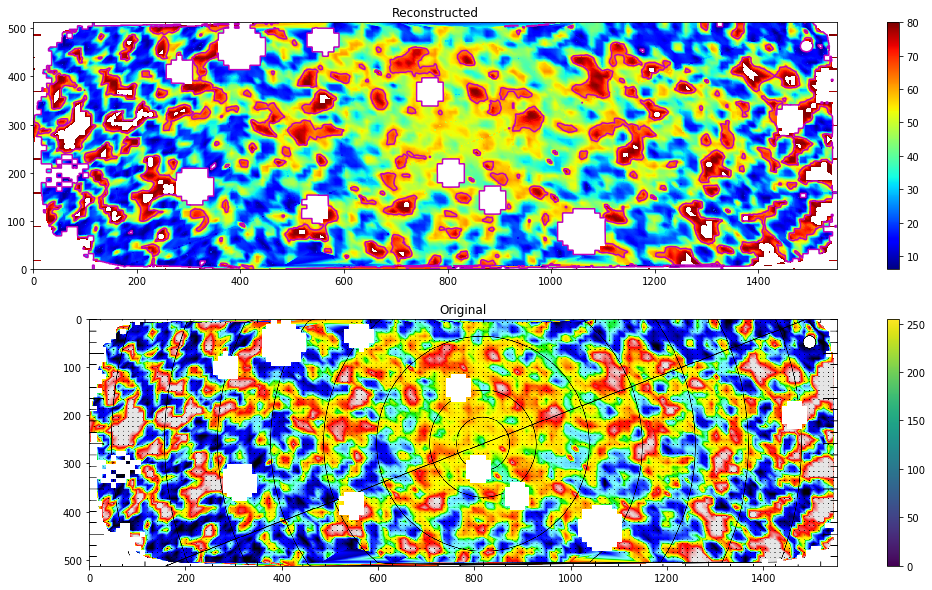

In [116]:
X,Y = np.meshgrid(np.arange(0.,1553,1), np.arange(0.,513,1))

fig = plt.figure(figsize=[18, 10])
plt.subplot(2,1,1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.jet)
quadmesh.set_clim(vmin=6.0, vmax=80.)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
CS = plt.contour(X, Y, Z, levels=[62.], colors=('m'))
plt.title('Reconstructed')

plt.subplot(2,1,2)
cax = plt.imshow(ImagePIL.open('VENGA_sig_los.png'))
cbar = fig.colorbar(cax)
plt.title('Original');

In [117]:
sig_los = Z
np.save('sig_los.npy', sig_los)

Теперь надо $\sigma_R$ извлечь, используя формулу выше.

Рассчитаем углы $\phi$ и проверим что верно:

In [118]:
import math

def dotproduct(v1, v2):
    return sum((a*b) for a, b in zip(v1, v2))

def length(v):
    return math.sqrt(dotproduct(v, v))

def angle(v1, v2):
    return math.acos(dotproduct(v1, v2) / (length(v1) * length(v2)))

In [119]:
phi = np.zeros(sig_los.shape)

for i in range(len(sig_los[0])):
    for j in range(len(sig_los)):
        x, y  = 813.5-i, 253.5-j
        phi[j][i] = angle(np.array([x,y]), np.array([1553., 1553*np.sin(22.5*np.pi/180.)-60.]))*180./np.pi

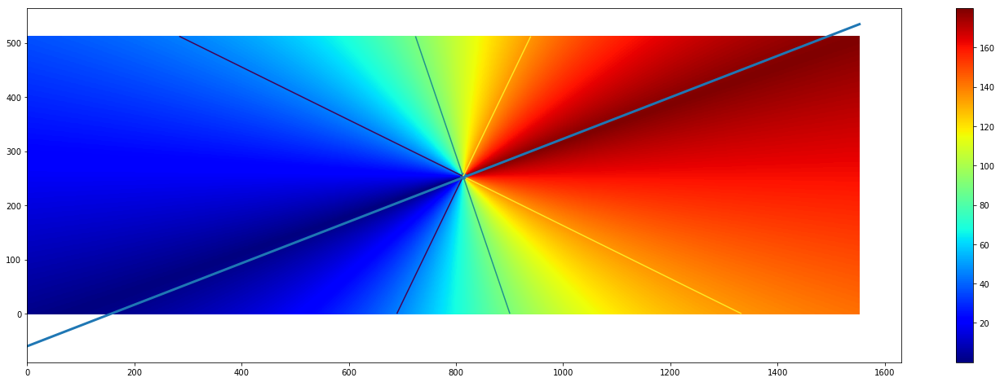

In [120]:
X,Y = np.meshgrid(np.arange(0.,1553,1), np.arange(0.,513,1))

plt.figure(figsize=[24, 8])
quadmesh = plt.pcolormesh(X, Y, phi, cmap=cm.jet)
# quadmesh.set_clim(vmin=6.0, vmax=80.)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')

CS = plt.contour(X, Y, phi, levels=[45., 90., 135.], aspect='auto')

plt.plot([0., 1553.], [0.-60., 1553*np.sin(22.5*np.pi/180.)-60.], '-', lw=3)
plt.scatter([813.5],[253.5],[50.])

In [121]:
sig_r_max = lambda sig, phi_: sig/np.sqrt(sin_i**2 * np.sin(phi_*np.pi/180.)**2 + 0.25*sin_i**2*np.cos(phi_*np.pi/180.)**2 + 0.09*cos_i**2) 
sig_r_min = lambda sig, phi_: sig/np.sqrt(sin_i**2 + 0.49*cos_i**2) 

In [122]:
sig_R_max = np.zeros(sig_los.shape)

for i in range(len(sig_los)):
    for j in range(len(sig_los[0])):
        sig_R_max[i][j] = sig_r_max(sig_los[i][j], phi[i][j])
        
sig_R_min = np.zeros(sig_los.shape)

for i in range(len(sig_los)):
    for j in range(len(sig_los[0])):
        sig_R_min[i][j] = sig_r_min(sig_los[i][j], phi[i][j])

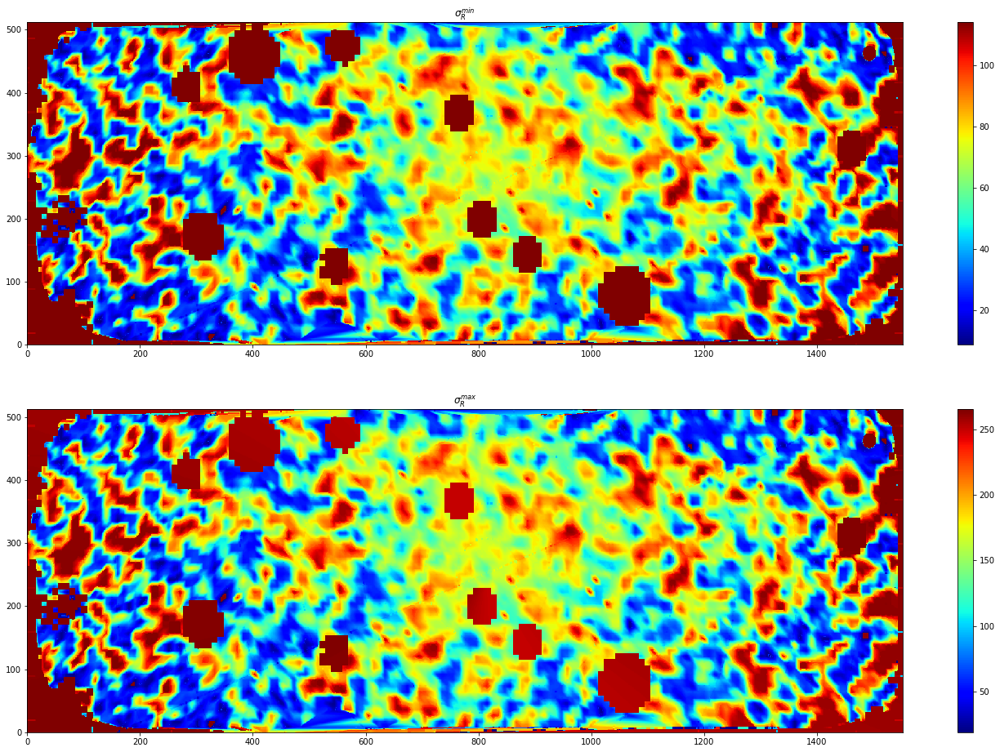

In [123]:
plt.figure(figsize=[24, 16])
plt.subplot(2,1,1)
quadmesh = plt.pcolormesh(X, Y, sig_R_min, cmap=cm.jet)
# quadmesh.set_clim(vmin=6.0, vmax=80.)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
plt.title(r'$\sigma_R^{min}$')

plt.subplot(2,1,2)
quadmesh = plt.pcolormesh(X, Y, sig_R_max, cmap=cm.jet)
# quadmesh.set_clim(vmin=6.0, vmax=80.)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
plt.title(r'$\sigma_R^{max}$')

In [124]:
np.save('sig_R_max.npy', sig_R_max)
np.save('sig_R_min.npy', sig_R_min)

# Все в одном

In [51]:
Sigma_HI_ = np.load('Sigma_HI_.npy')
sig_los = np.load('sig_los.npy')
c_g_ = np.load('c_g_.npy')
c_CO_ = np.load('c_CO_.npy')
dist_ = np.load('dist_.npy')
# Sigma_BIMA_CO_ = np.load('Sigma_BIMA_CO_.npy')
Sigma_HERACLES_CO_ = np.load('HERACLES_CO_.npy')
log_Halpha_SFR_ = np.load('log_Halpha_SFR_.npy')
# Sigma_s = np.load('Sigma_s.npy')
sig_R_max = np.load('sig_R_max.npy')
sig_R_min = np.load('sig_R_min.npy')
Sigma_s_Leroy_ = np.load('Sigma_s_Leroy_.npy')

r_g = np.load('r_g.npy')
vel_g = np.load('vel_g.npy')
gas_approx = poly1d(polyfit(r_g, vel_g, deg=5))
def epicyclicFreq_real(poly_gas, R, resolution):
    return sqrt(2.0) * poly_gas(R) * sqrt(1 + R * poly_gas.deriv()(R) / poly_gas(R)) / (R * resolution )

def add_SFR_contours(levels=[-2.25, -1.], colors=('red', 'blue'), X=None, Y=None):
#     X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
    if X is None and Y is None:
        X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
    CS = plt.contour(X, Y, log_Halpha_SFR_, levels=levels, colors=colors)
#     CS3 = plt.contourf(X, Y, log_Halpha_SFR_, [-1., -0.8], colors=('white'))

Общая картинка:

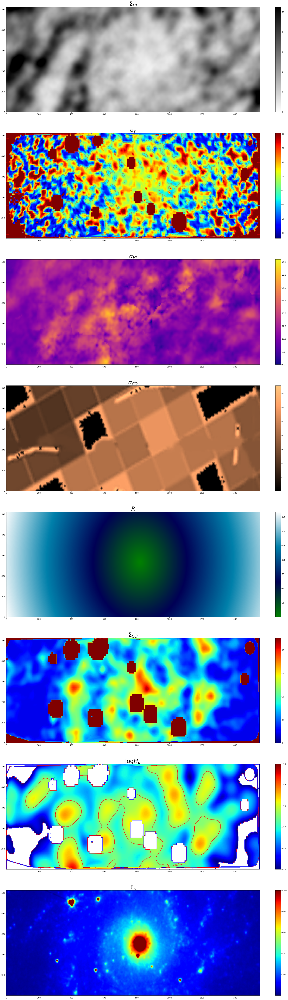

In [21]:
import matplotlib.patches as patches

X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))

plt.figure(figsize=[30, 96])
plt.subplot(8, 1, 1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Sigma_HI_, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0., vmax=10.5)
plt.colorbar()
plt.title(r'$\Sigma_{HI}$', fontsize=30)


plt.subplot(8, 1, 2)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
CS = plt.contour(X, Y, sig_los, levels=[40., 70.], aspect='auto', alpha=0.5, colors='r')
plt.clabel(CS, inline=1, fontsize=10)
plt.title(r'$\sigma_{s}$', fontsize=30)
quadmesh2 = plt.pcolormesh(X, Y, sig_los, cmap=cm.jet)
# quadmesh2.set_clim(vmin=0., vmax=10.5)
plt.colorbar()

#bulge
circle = plt.Circle((512, 512), 10., color='b', fill=False)
plt.gca().add_artist(circle)


plt.subplot(8, 1, 3)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, c_g_, cmap=cm.plasma)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=5., vmax=25.5)
plt.colorbar()
plt.title(r'$\sigma_{HI}$', fontsize=30)

plt.subplot(8, 1, 4)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, c_CO_, cmap=cm.copper)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=.1, vmax=15.1)
plt.colorbar()
plt.title(r'$\sigma_{CO}$', fontsize=30)

plt.subplot(8, 1, 5)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, dist_, cmap=cm.ocean)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
# quadmesh.set_clim(vmin=.1, vmax=15.1)
plt.colorbar()
plt.title(r'$R$', fontsize=30)

plt.subplot(8, 1, 6)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, Sigma_HERACLES_CO_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0., vmax=45.19)
plt.colorbar()
plt.title(r'$\Sigma_{CO}$', fontsize=30)

plt.subplot(8, 1, 7)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, log_Halpha_SFR_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=-3.5, vmax=-1.)
plt.colorbar()
plt.title(r'$\log H_{\alpha}$', fontsize=30)
add_SFR_contours()

plt.subplot(8, 1, 8)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, Sigma_s_Leroy_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=1, vmax=1000.)
plt.colorbar()
plt.title(r'$\Sigma_{s}$', fontsize=30)

# X,Y = np.meshgrid(np.arange(0.,len(c_g),1), np.arange(0.,len(c_g[0]),1))
# CS = plt.contour(X[470:560, 380:650], Y[470:560, 380:650], c_g[470:560, 380:650], levels=[5., 10., 20.], aspect='auto', alpha=0.5)

plt.savefig('scaled_maps_column.png', format='png', bbox_inches='tight')
plt.show()

# $Q_{\rm eff}$

In [ ]:
# %%time

# G = 4.32
# Qeff_max = np.zeros(dist_.shape)
# Qeff_min = np.zeros(dist_.shape)
# bark = np.zeros(dist_.shape)
# bark_max = np.zeros(dist_.shape)

# Sigma = Sigma_HI_ + Sigma_HERACLES_CO_
# vfunc = np.vectorize(lambda l: epicyclicFreq_real(gas_approx, l, scale))
# kappa = vfunc(dist_)
# Qgs = np.divide(np.multiply(kappa, c_g_), Sigma*math.pi * G)
# Qss_max = np.divide(np.multiply(kappa, sig_R_max), Sigma_s_Leroy_*3.36 * G)
# Qss_min = np.divide(np.multiply(kappa, sig_R_min), Sigma_s_Leroy_*3.36 * G)

# for i, row in enumerate(dist_):
#     if i%100 == 0:
#         print i
#     for j, col in enumerate(dist_[0]):
#         c = c_g_[i][j]
#         s_R_max = sig_R_max[i][j]
#         s_R_min = sig_R_min[i][j]
#         Qg = Qgg[i][j]
#         Qs_max = Qss_max[i][j]
#         Qs_min = Qss_min[i][j]
#         try:
#             root_for_max, qeff = findInvKinemQeffBrentq(Qs_min, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
#         except ValueError:
#             qeff = 0.01
#             root_for_max = -1.
#         Qeff_min[i][j] = 1./qeff
#         bark[i][j] = root_for_max
        
#         try:
#             root_for_max, qeff = findInvKinemQeffBrentq(Qs_max, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
#         except ValueError:
#             qeff = 0.01
#             root_for_max = -1.
#         Qeff_max[i][j] = 1./qeff
#         bark_max[i][j] = root_for_max

In [23]:
%%time

G = 4.32
Qeff_max = np.zeros(dist_.shape)
Qeff_min = np.zeros(dist_.shape)
bark = np.zeros(dist_.shape)
bark_max = np.zeros(dist_.shape)
Qgs = np.zeros(dist_.shape)
Qss_min = np.zeros(dist_.shape)
Qss_max = np.zeros(dist_.shape)

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j]
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
        Qg = kappa * c / (math.pi * G * Sigma)
        Qs_max = kappa * s_R_max / (3.36 * G * Sigma_s_)
        Qs_min = kappa * s_R_min / (3.36 * G * Sigma_s_)
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_min, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            qeff = 0.01
            root_for_max = -1.
        Qeff_min[i][j] = 1./qeff
        bark[i][j] = root_for_max
        
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_max, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            qeff = 0.01
            root_for_max = -1.
        Qeff_max[i][j] = 1./qeff
        bark_max[i][j] = root_for_max
        
        Qgs[i][j] = Qg
        Qss_min[i][j] = Qs_min
        Qss_max[i][j] = Qs_max

0
100
200
300
400
500
Wall time: 20min 43s


In [24]:
np.save('Qeff_min.npy', Qeff_min)
np.save('bark.npy', bark)
np.save('Qeff_max.npy', Qeff_min)
np.save('bark_max.npy', bark)
np.save('Qgs.npy', Qgs)
np.save('Qss_min.npy', Qss_min)
np.save('Qss_max.npy', Qss_max)

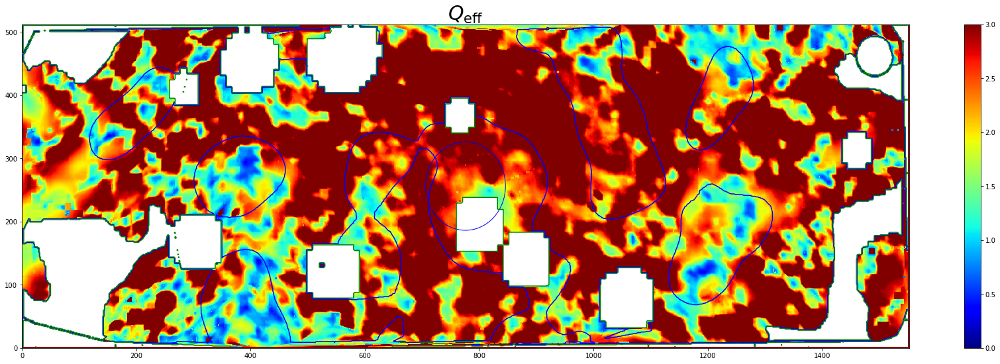

In [41]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 9])
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
quadmesh = plt.pcolormesh(X, Y, Qeff_min, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0., vmax=3.)
plt.colorbar()

plt.title(r'$Q_{\rm eff}$', fontsize=30)

add_SFR_contours(colors=('b', 'g'))

#bulge
circle = plt.Circle((Nx/2, Ny/2), 15*1553./(157.3+175.92), color='b', fill=False)
plt.gca().add_artist(circle)

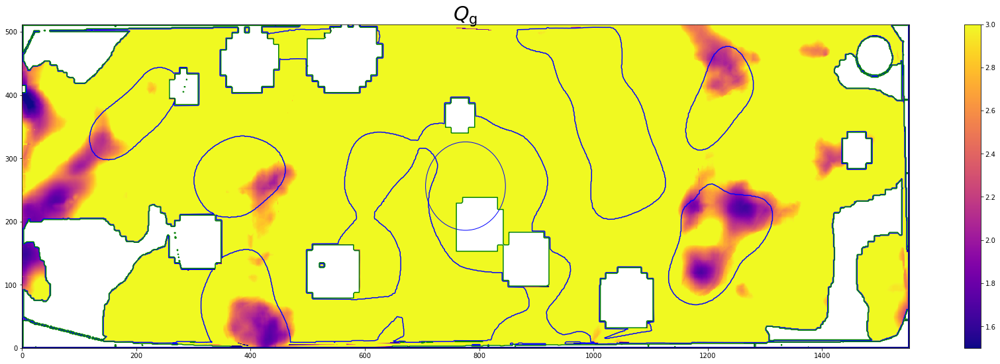

In [40]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 9])
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.plasma)
quadmesh.set_clim(vmin=1.5, vmax=3.)
plt.colorbar()

add_SFR_contours(colors=('b', 'g'))

plt.title(r'$Q_{\rm g}$', fontsize=30)

#bulge
circle = plt.Circle((Nx/2, Ny/2), 15*1553./(157.3+175.92), color='b', fill=False)
plt.gca().add_artist(circle)

In [88]:
def mark_stars():
    X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
#     CS = plt.contour(X, Y, log_Halpha_SFR_, levels=levels, colors=colors)
#     CS3 = plt.contourf(X, Y, sig_los, [80., 81.], colors=('white'))
    CS3 = plt.contourf(X, Y, sig_los, [80., 81.], colors=('white'))
#     CS3 = plt.contourf(X, Y, Sigma_HERACLES_CO_, [44., 45.], colors=('white'))

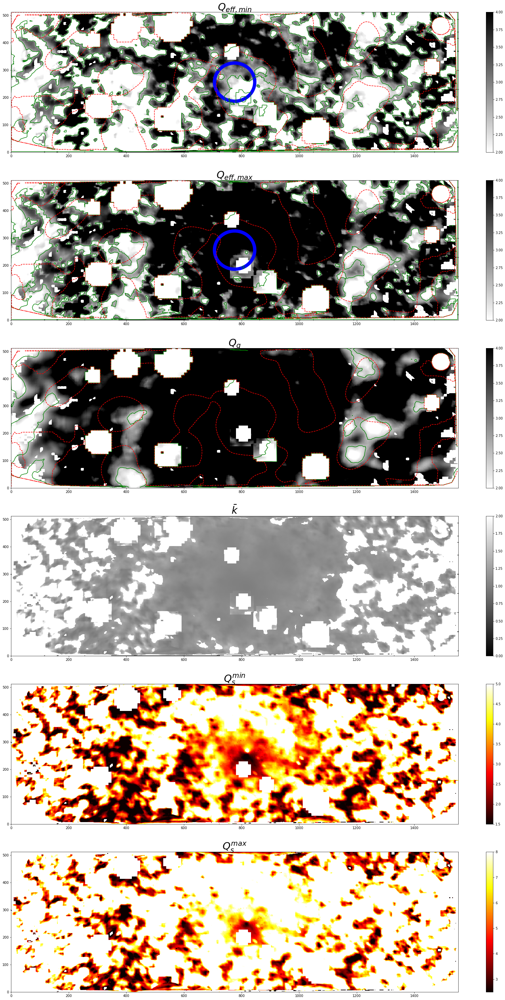

In [89]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 54])

plt.subplot(6,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qeff_min, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,min}$', fontsize=30)
add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars()
#bulge
# circle = plt.Circle((512, 512), 10., color='b', fill=False, lw=10)
# plt.gca().add_artist(circle)
circle = plt.Circle((Nx/2, Ny/2), 15*1553./(157.3+175.92), color='b', fill=False, lw=10)
plt.gca().add_artist(circle)


plt.subplot(6,1,2)
quadmesh = plt.pcolormesh(X, Y, Qeff_max, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_max, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,max}$', fontsize=30)
add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars()
#bulge
circle = plt.Circle((Nx/2, Ny/2), 15*1553./(157.3+175.92), color='b', fill=False, lw=10)
plt.gca().add_artist(circle)


plt.subplot(6,1,4)
quadmesh = plt.pcolormesh(X, Y, bark, cmap=cm.gray)
quadmesh.set_clim(vmin=0., vmax=2.)
plt.colorbar()
plt.title(r'$\bar{k}$', fontsize=30)
mark_stars()

plt.subplot(6,1,3)
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qgs, levels=[2.5], colors=('g'))
plt.title(r'$Q_{g}$', fontsize=30)
add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars()


plt.subplot(6,1,5)
quadmesh = plt.pcolormesh(X, Y, Qss_min, cmap=cm.hot)
quadmesh.set_clim(vmin=1.5, vmax=5.)
plt.colorbar()
plt.title(r'$Q_{s}^{min}$', fontsize=30)
mark_stars()

plt.subplot(6,1,6)
quadmesh = plt.pcolormesh(X, Y, Qss_max, cmap=cm.hot)
quadmesh.set_clim(vmin=2.5, vmax=8.)
plt.colorbar()
plt.title(r'$Q_{s}^{max}$', fontsize=30)
mark_stars()

plt.savefig('result_maps_column2.png', format='png', bbox_inches='tight')
plt.show()

https://stats.stackexchange.com/questions/73646/how-do-i-test-that-two-continuous-variables-are-independent

In [56]:
np.count_nonzero(np.isnan(log_Halpha_SFR_.ravel())), log_Halpha_SFR_.ravel().shape

(4128, (796689L,))

In [57]:
np.count_nonzero(np.isnan(Qeff_min.ravel())), Qeff_min.ravel().shape

(0, (796689L,))

In [61]:
print np.corrcoef(Qeff_min.ravel(), np.nan_to_num(log_Halpha_SFR_.ravel()))[0][1]
print np.corrcoef(Qeff_max.ravel(), np.nan_to_num(log_Halpha_SFR_.ravel()))[0][1]
print np.corrcoef(np.nan_to_num(Qgs.ravel()), np.nan_to_num(log_Halpha_SFR_.ravel()))[0][1]

0.194115115224
0.12930007291
-0.00450541791072


In [62]:
print np.corrcoef(Qeff_min.ravel(), np.nan_to_num(log_Halpha_SFR_.ravel()))[0][1]
print np.corrcoef(Qeff_max.ravel(), np.nan_to_num(log_Halpha_SFR_.ravel()))[0][1]
print np.corrcoef(np.nan_to_num(Qgs.ravel()), np.nan_to_num(log_Halpha_SFR_.ravel()))[0][1]

0.143887194808
0.0710219043289
-0.0316996878807


(0.0, 4.0)

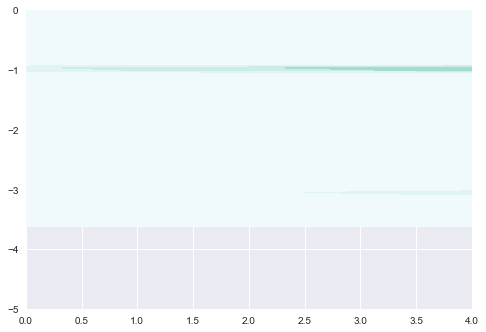

In [67]:
import seaborn as sns


ax = sns.kdeplot(Qeff_min.ravel(), np.nan_to_num(log_Halpha_SFR_.ravel()), shade=True)

plt.ylim(-5., 0.)
plt.xlim(0., 4.)

In [76]:
plt.hist2d(Qeff_min.ravel(), np.nan_to_num(log_Halpha_SFR_.ravel()), (100, 100), cmap=plt.cm.jet)
plt.ylim(-5., 0.)
plt.xlim(0., 4.)
plt.colorbar()

ValueError: Image size of 162045x332 pixels is too large. It must be less than 2^16 in each direction.

TypeError: Image data can not convert to float

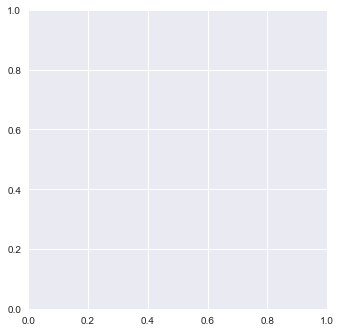

In [70]:
h2d = np.histogram2d(Qeff_min.ravel(), np.nan_to_num(log_Halpha_SFR_.ravel()), bins=50)
plt.imshow(h2d);

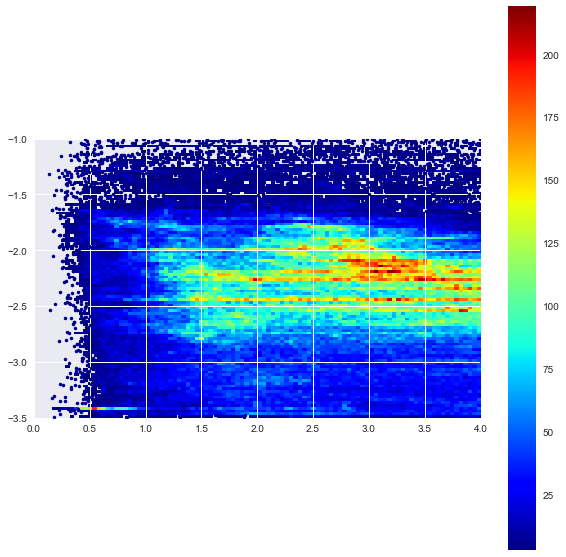

In [79]:
import scipy

#histogram definition
xyrange = [[0,4],[-3.5,-1.]] # data range
bins = [100,100] # number of bins
thresh = 3  #density threshold

# plt.ylim(-5., 0.)
# plt.xlim(0., 4.)

#data definition
# N = 1e5;
# xdat, ydat = np.random.normal(size=N), np.random.normal(1, 0.6, size=N)
xdat, ydat = Qeff_min.ravel(), np.nan_to_num(log_Halpha_SFR_.ravel())

# histogram the data
hh, locx, locy = scipy.histogram2d(xdat, ydat, range=xyrange, bins=bins)
posx = np.digitize(xdat, locx)
posy = np.digitize(ydat, locy)

#select points within the histogram
ind = (posx > 0) & (posx <= bins[0]) & (posy > 0) & (posy <= bins[1])
hhsub = hh[posx[ind] - 1, posy[ind] - 1] # values of the histogram where the points are
xdat1 = xdat[ind][hhsub < thresh] # low density points
ydat1 = ydat[ind][hhsub < thresh]
hh[hh < thresh] = np.nan # fill the areas with low density by NaNs

plt.figure(figsize=[10,10])
plt.imshow(np.flipud(hh.T),cmap='jet',extent=np.array(xyrange).flatten(), interpolation='none', origin='upper')
plt.colorbar()   
plt.plot(xdat1, ydat1, '.',color='darkblue')
plt.show()

# Appendix

In [37]:
w = WCS(naxis=2)

In [56]:
w.wcs.crpix = [-234.75, 8.3393]
w.wcs.cdelt = numpy.array([-0.066667, 0.066667])
w.wcs.crval = [0, -20]
w.wcs.ctype = ["RA---AZP", "DEC--AZP"]
w.wcs.set_pv([(2, 1, 45.0)])

http://docs.astropy.org/en/stable/visualization/wcsaxes/ticks_labels_grid.html

http://docs.astropy.org/en/stable/wcs/

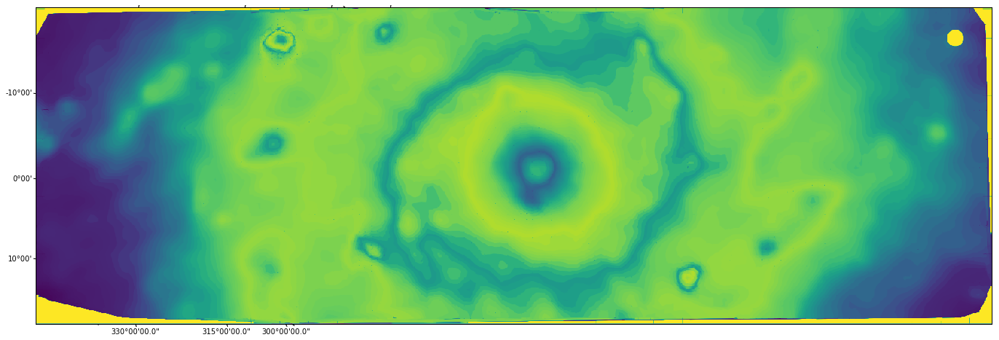

In [57]:
fig = plt.figure(figsize=[24, 8])
ax = fig.add_subplot(1, 1, 1, projection=w)
lon = ax.coords[0]
lat = ax.coords[1]
lon.set_major_formatter('dd:mm:ss.s')
lat.set_major_formatter('dd:mm')
plt.imshow(img_dilation)

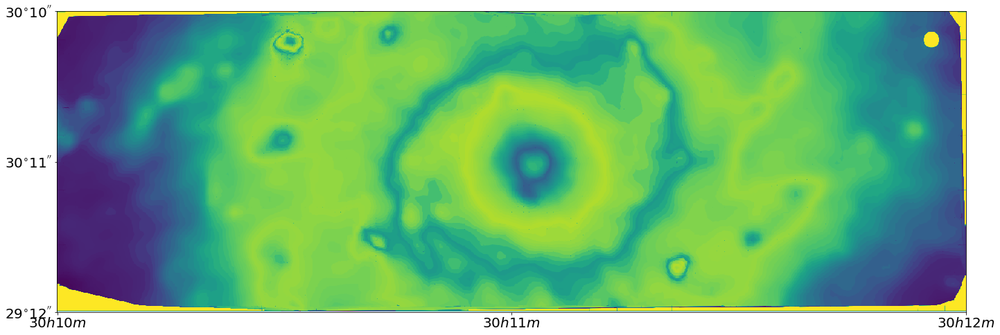

In [72]:
fig = plt.figure(figsize=[24, 8])
ax = fig.add_subplot(1, 1, 1)
# lon.set_major_formatter('dd:mm:ss.s')
# lat.set_major_formatter('dd:mm')
plt.imshow(img_dilation)

ticksLocationsRA = linspace(0, len(img_dilation[0]), 3)
# ticksLabelsRA = degrees_to_hhmmss(ticksLocatoinsRA)
# xticks(ticksLocationsRA, ticksLabelsRA)
plt.xticks(ticksLocationsRA, [r'$30h10m$', r'$30h11m$', r'$30h12m$'])

# The same with DEC coodinates
ticksLocationsDEC = linspace(0, len(img_dilation), 3)
# ticksLabelsDEC = degrees_to_ddmmss(ticksLocatoinsDEC)
# yticks(ticksLocationsDEC, ticksLabelsDEC)
yticks(ticksLocationsDEC, [r"$30^{\circ}10^{''}$", r"$30^{\circ}11^{''}$", r"$29^{\circ}12^{''}$"])

plt.tick_params(axis='both', which='major', labelsize=20)
plt.tick_params(axis='both', which='minor', labelsize=18)

In [ ]:
lb = SkyCoord(ra='01h37m35s', dec='+15d34.5m')
rb = SkyCoord('01h35m49.5s', '+15d34.5m')

lu = SkyCoord('01h37m35s', '+16d00m')
ru = SkyCoord('01h35m49.5s', '+16d00m')

def pix_to_coordinates(xpix, ypix):
    xrange_ = lb.data.lon.deg + (rb.data.lon.deg-lb.data.lon.deg)/1024. * (xpix)
    yrange_ = lb.data.lat.deg + (lu.data.lat.deg-lb.data.lat.deg)/1024. * (ypix)
    return SkyCoord(ra='{}deg'.format(xrange_), dec='{}deg'.format(yrange_))

pix_to_coordinates(512,512).ra.hms